In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import gc
import warnings
warnings.filterwarnings('ignore')
pd.pandas.set_option('display.max_columns', None)

In [2]:
df = pd.read_feather('optimized_nfl_newdata.feather')
df.head()

,gameId,season,week,gameDate,gameTimeEastern,homeTeamAbbr,visitorTeamAbbr,playId,nflId,pff_role,pff_positionLinedUp,pff_hit,pff_hurry,pff_sack,pff_beatenByDefender,pff_hitAllowed,pff_hurryAllowed,pff_sackAllowed,pff_nflIdBlockedPlayer,pff_blockType,pff_backFieldBlock,height,weight,birthDate,collegeName,officialPosition,displayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,penaltyYards,prePenaltyPlayResult,playResult,foulName1,foulNFLId1,foulName2,foulNFLId2,foulName3,foulNFLId3,absoluteYardlineNumber,offenseFormation,personnelO,defendersInBox,personnelD,dropBackType,pff_playAction,pff_passCoverage,pff_passCoverageType,frameId,time,jerseyNumber,team,playDirection,x,y,s,a,dis,o,dir,event
0,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,97,25511,Pass,QB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,6-4,225,1977-08-03,Michigan,QB,Tom Brady,(13:33) (Shotgun) T.Brady pass incomplete deep...,1,3,2,TB,DAL,TB,33,13:33,0,0,I,NaN,0,0,None,NaN,None,NaN,None,NaN,43.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man,1,2021-09-10T00:26:31.100,12.0,TB,right,37.770000,24.219999,0.29,0.30,0.03,165.160004,84.989998,None
1,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,97,25511,Pass,QB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,6-4,225,1977-08-03,Michigan,QB,Tom Brady,(13:33) (Shotgun) T.Brady pass incomplete deep...,1,3,2,TB,DAL,TB,33,13:33,0,0,I,NaN,0,0,None,NaN,None,NaN,None,NaN,43.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man,2,2021-09-10T00:26:31.200,12.0,TB,right,37.779999,24.219999,0.23,0.11,0.02,164.330002,92.870003,None
2,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,97,25511,Pass,QB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,6-4,225,1977-08-03,Michigan,QB,Tom Brady,(13:33) (Shotgun) T.Brady pass incomplete deep...,1,3,2,TB,DAL,TB,33,13:33,0,0,I,NaN,0,0,None,NaN,None,NaN,None,NaN,43.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man,3,2021-09-10T00:26:31.300,12.0,TB,right,37.779999,24.240000,0.16,0.10,0.01,160.240005,68.550003,None
3,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,97,25511,Pass,QB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,6-4,225,1977-08-03,Michigan,QB,Tom Brady,(13:33) (Shotgun) T.Brady pass incomplete deep...,1,3,2,TB,DAL,TB,33,13:33,0,0,I,NaN,0,0,None,NaN,None,NaN,None,NaN,43.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man,4,2021-09-10T00:26:31.400,12.0,TB,right,37.730000,24.250000,0.15,0.24,0.06,152.130005,296.850006,None
4,2021090900,2021,1,09/09/2021,20:20:00,TB,DAL,97,25511,Pass,QB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,6-4,225,1977-08-03,Michigan,QB,Tom Brady,(13:33) (Shotgun) T.Brady pass incomplete deep...,1,3,2,TB,DAL,TB,33,13:33,0,0,I,NaN,0,0,None,NaN,None,NaN,None,NaN,43.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man,5,2021-09-10T00:26:31.500,12.0,TB,right,37.689999,24.260000,0.25,0.18,0.04,148.330002,287.549988,None


In [34]:
df.shape

(7952692, 70)

In [35]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7952692 entries, 0 to 7952691
Data columns (total 70 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   gameId                  int32  
 1   season                  int32  
 2   week                    int32  
 3   gameDate                object 
 4   gameTimeEastern         object 
 5   homeTeamAbbr            object 
 6   visitorTeamAbbr         object 
 7   playId                  int32  
 8   nflId                   int32  
 9   pff_role                object 
 10  pff_positionLinedUp     object 
 11  pff_hit                 float32
 12  pff_hurry               float32
 13  pff_sack                float32
 14  pff_beatenByDefender    float32
 15  pff_hitAllowed          float32
 16  pff_hurryAllowed        float32
 17  pff_sackAllowed         float32
 18  pff_nflIdBlockedPlayer  float32
 19  pff_blockType           object 
 20  pff_backFieldBlock      float32
 21  height                  object 

In [4]:
df.dtypes.head(60)

gameId                             int64
season                             int64
week                               int64
gameDate                          object
gameTimeEastern                   object
homeTeamAbbr                      object
visitorTeamAbbr                   object
playId                             int64
nflId                              int64
pff_role                          object
pff_positionLinedUp               object
pff_hit                          float64
pff_hurry                        float64
pff_sack                         float64
pff_beatenByDefender             float64
pff_hitAllowed                   float64
pff_hurryAllowed                 float64
pff_sackAllowed                  float64
pff_nflIdBlockedPlayer           float64
pff_blockType                     object
pff_backFieldBlock               float64
height                            object
weight                             int64
birthDate                         object
collegeName     

## Missing values

In [11]:
col_with_na = [col for col in df.columns if df[col].isnull().sum()>1]

In [12]:
for col in col_with_na:
    print(f'{col}-{np.round(df[col].isnull().mean()*100,4)} %null values')

pff_hit-50.0 %null values
pff_hurry-50.0 %null values
pff_sack-50.0 %null values
pff_beatenByDefender-74.2699 %null values
pff_hitAllowed-74.2699 %null values
pff_hurryAllowed-74.2699 %null values
pff_sackAllowed-74.2699 %null values
pff_nflIdBlockedPlayer-75.0723 %null values
pff_blockType-74.3693 %null values
pff_backFieldBlock-74.37 %null values
birthDate-10.3978 %null values
collegeName-9.8893 %null values
yardlineSide-1.4936 %null values
penaltyYards-90.2375 %null values
foulName1-90.4823 %null values
foulNFLId1-90.4823 %null values
foulName2-99.5696 %null values
foulNFLId2-99.5696 %null values
foulName3-99.9873 %null values
foulNFLId3-99.9873 %null values
absoluteYardlineNumber-0.01 %null values
offenseFormation-0.0835 %null values
personnelO-0.01 %null values
defendersInBox-0.0835 %null values
personnelD-0.01 %null values
dropBackType-6.6769 %null values


## Discrete cols

In [13]:
col_with_finite = [col for col in df.columns if df[col].nunique()<25]

In [14]:
col_with_finite

['season',
 'week',
 'gameDate',
 'gameTimeEastern',
 'pff_role',
 'pff_hit',
 'pff_hurry',
 'pff_sack',
 'pff_beatenByDefender',
 'pff_hitAllowed',
 'pff_hurryAllowed',
 'pff_sackAllowed',
 'pff_blockType',
 'pff_backFieldBlock',
 'height',
 'officialPosition',
 'quarter',
 'down',
 'passResult',
 'foulName2',
 'foulName3',
 'foulNFLId3',
 'offenseFormation',
 'defendersInBox',
 'dropBackType',
 'pff_playAction',
 'pff_passCoverage',
 'pff_passCoverageType',
 'playDirection']

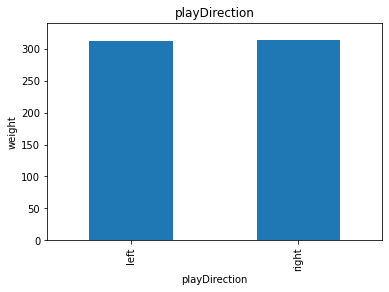

In [14]:
for col in col_with_finite:
    dfdiscrete = df.copy()
    dfdiscrete.groupby(col)['weight'].median().plot.bar()
    plt.xlabel(col)
    plt.ylabel('weight')
    plt.title(col)
    plt.savefig(f'{col}_weight.png')

In [15]:
dfdiscrete.groupby(col)['weight'].median()

playDirection
left     238.0
right    238.0
Name: weight, dtype: float64

In [ ]:
for col in dfnew.columns:
    if dfnew[col].nunique() > 1 and dfnew[col].nunique() <= 15:
        try:
            plt.figure(figsize = (15,8))
            sns.histplot(dfnew[col])
            plt.savefig(f'cat_{col}.png')
        except:
            print(f'Error: cat_{col}.png' )

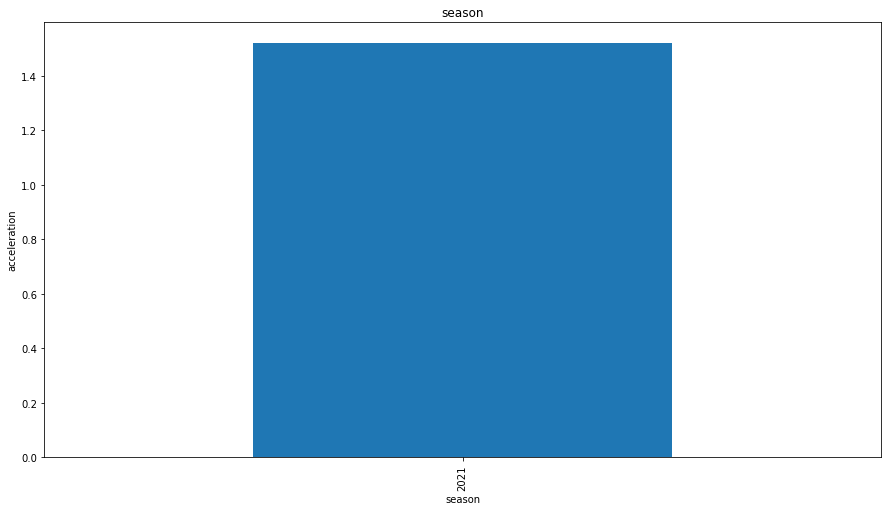

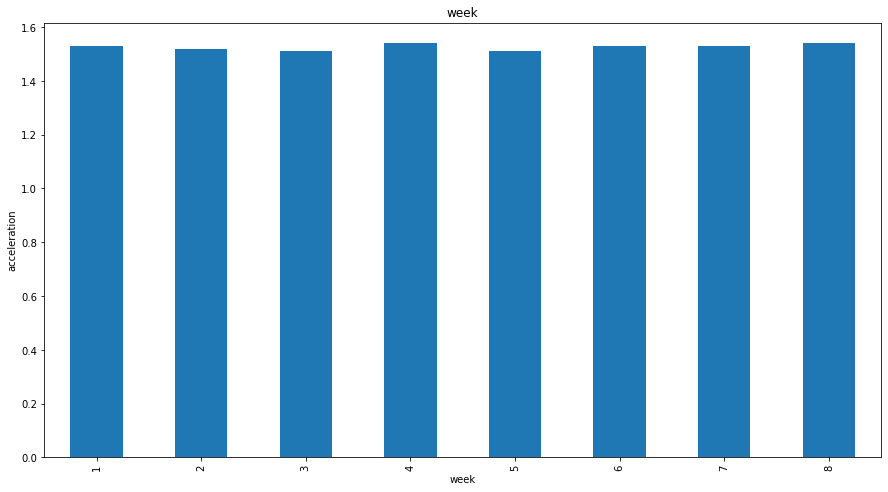

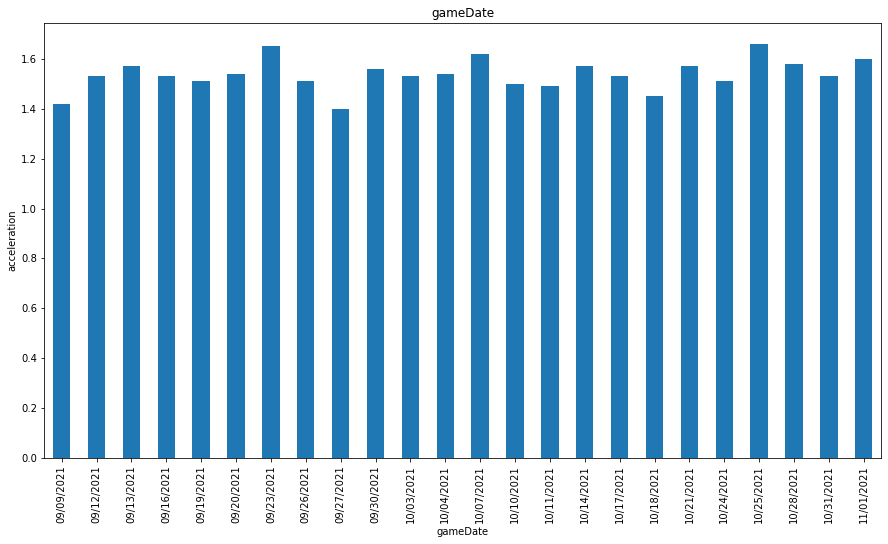

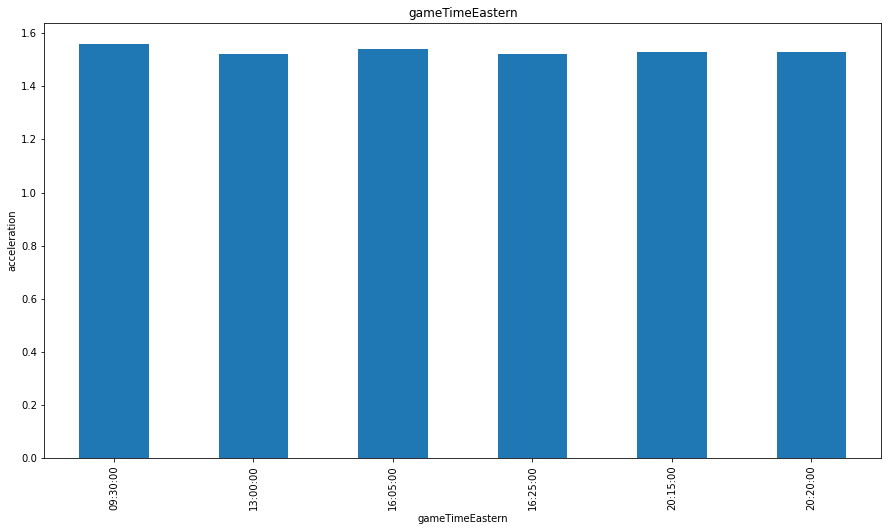

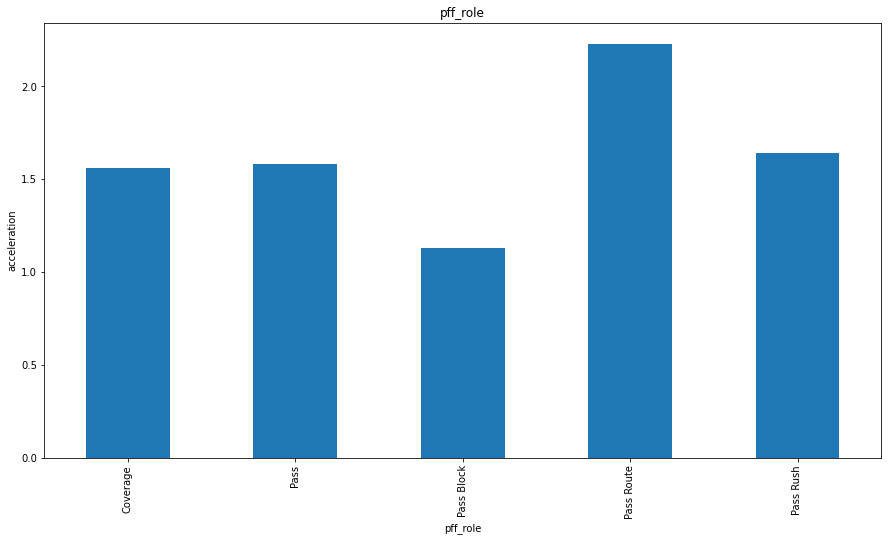

...

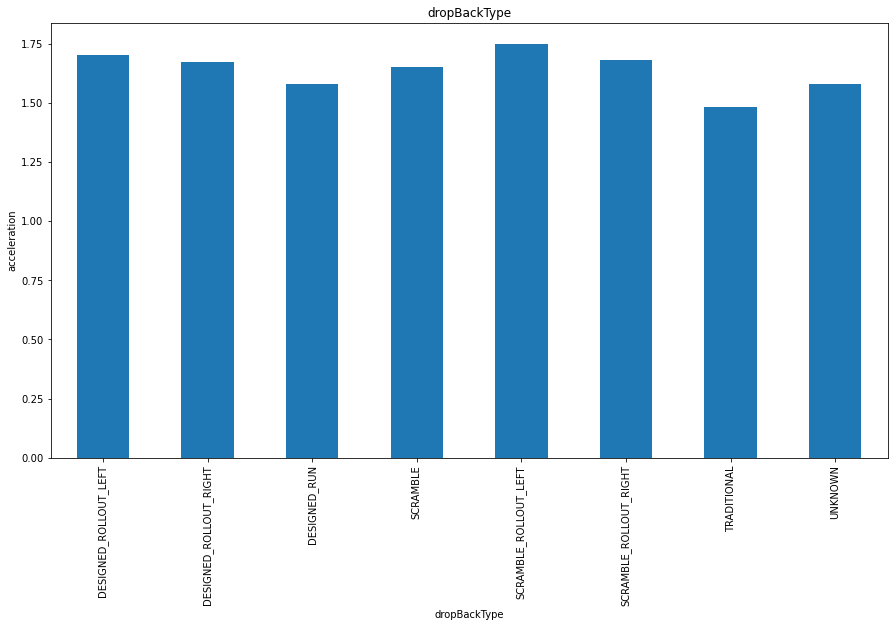

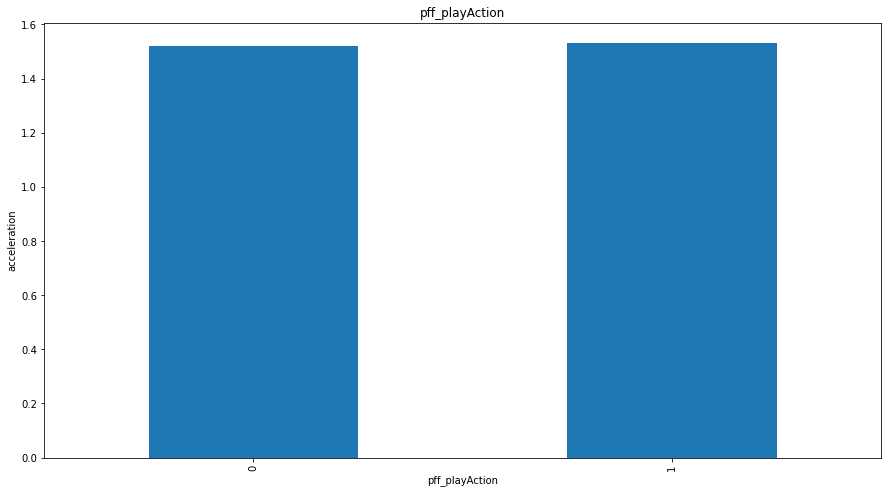

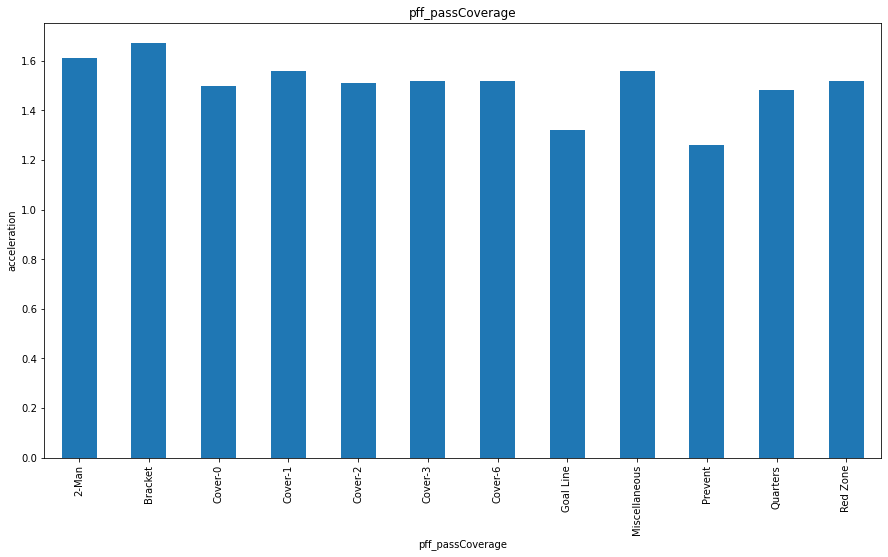

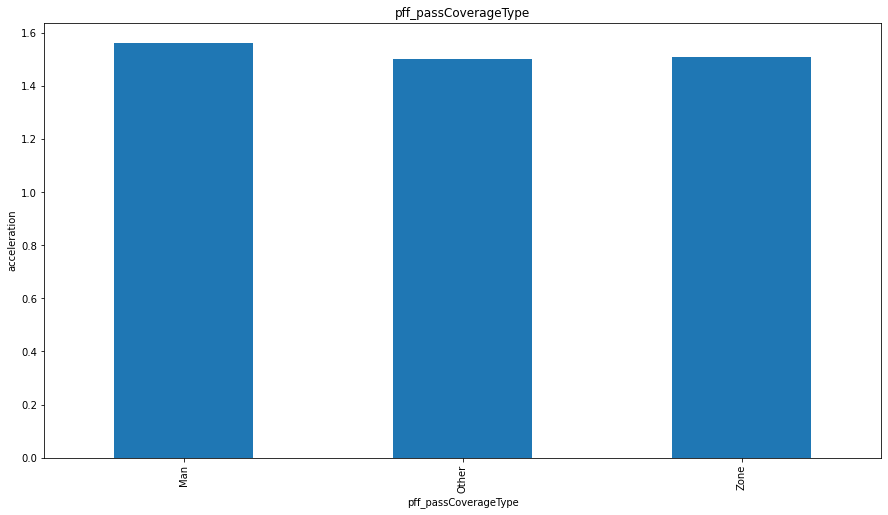

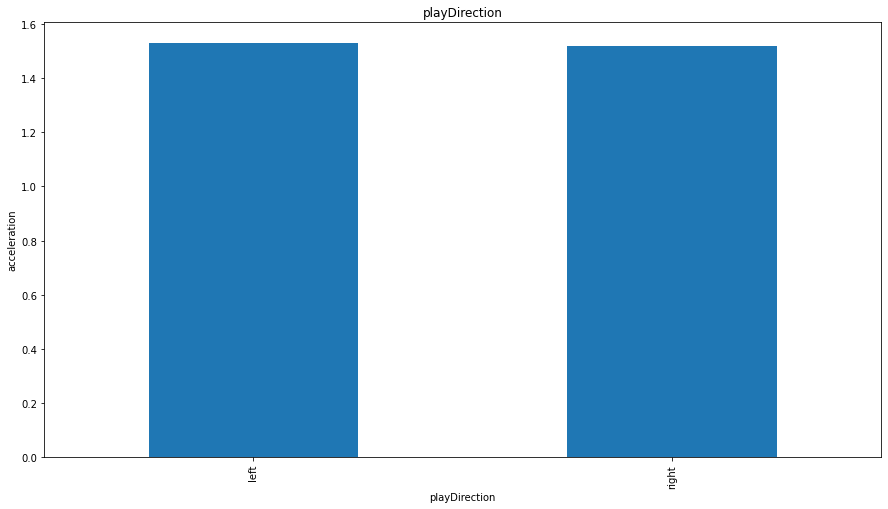

In [16]:
for col in col_with_finite:
    dfacce = df.copy()
    plt.figure(figsize = (15,8))
    dfacce.groupby(col)['a'].median().plot.bar()
    plt.xlabel(col)
    plt.xticks(rotation=45)
    plt.ylabel('acceleration')
    plt.title(col)
    plt.savefig(f'{col}_acce.png')

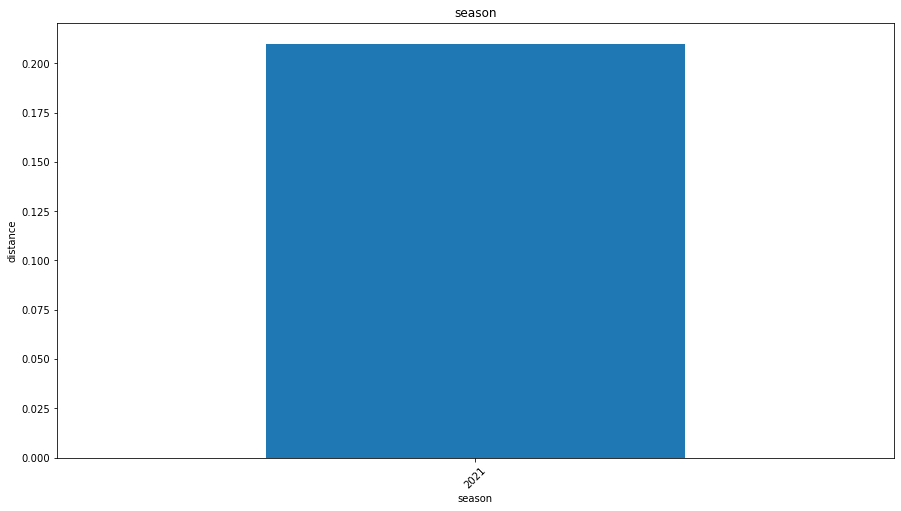

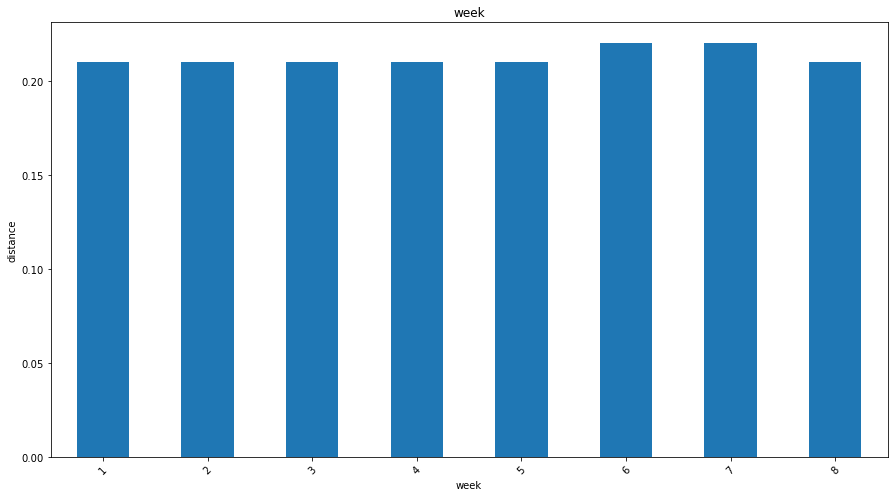

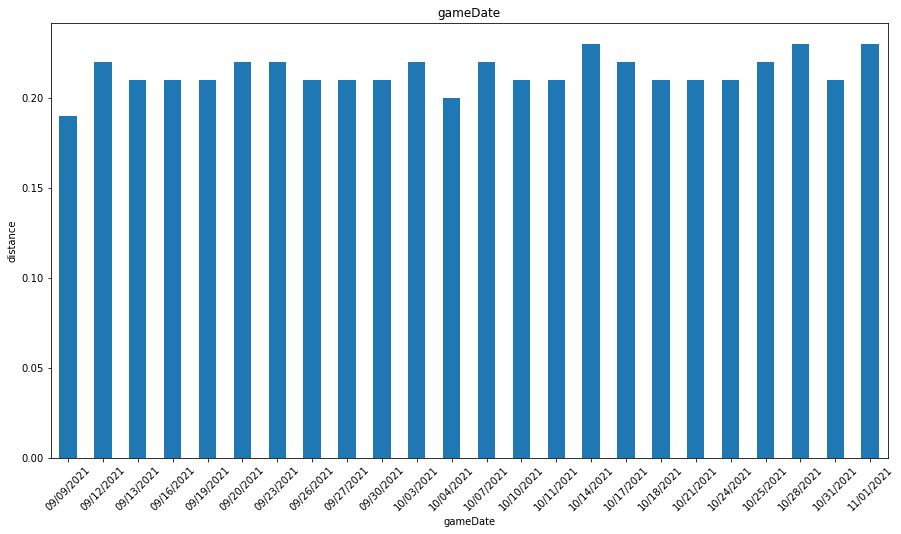

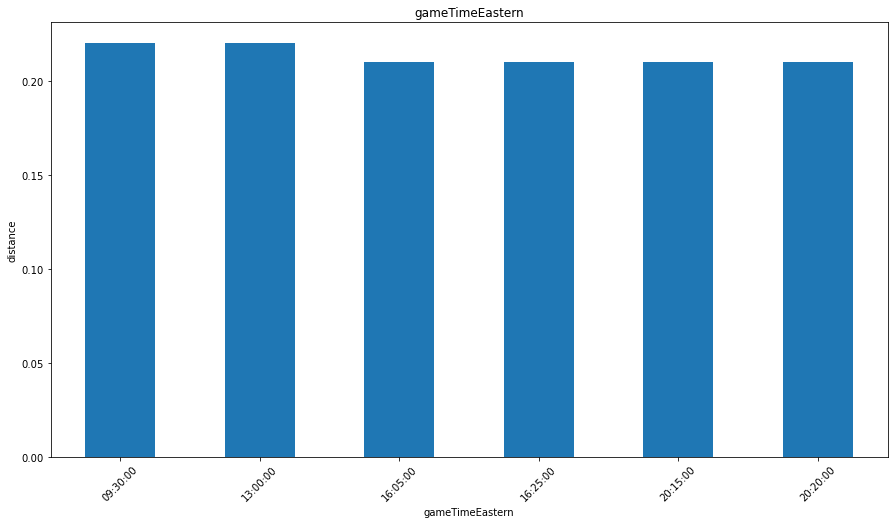

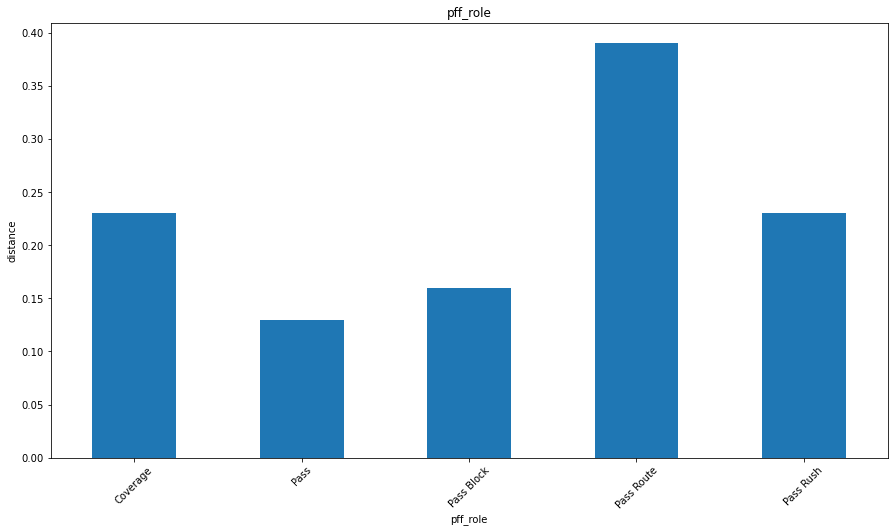

...

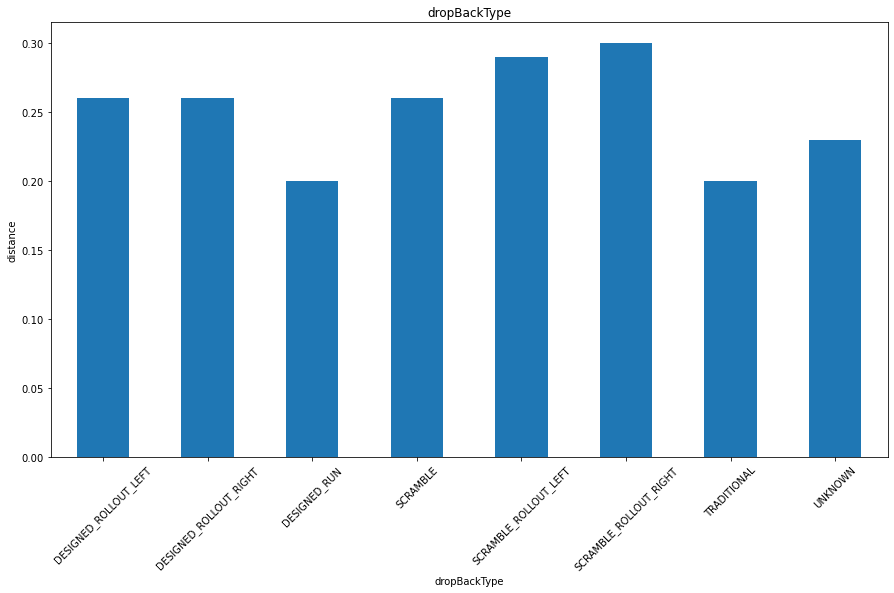

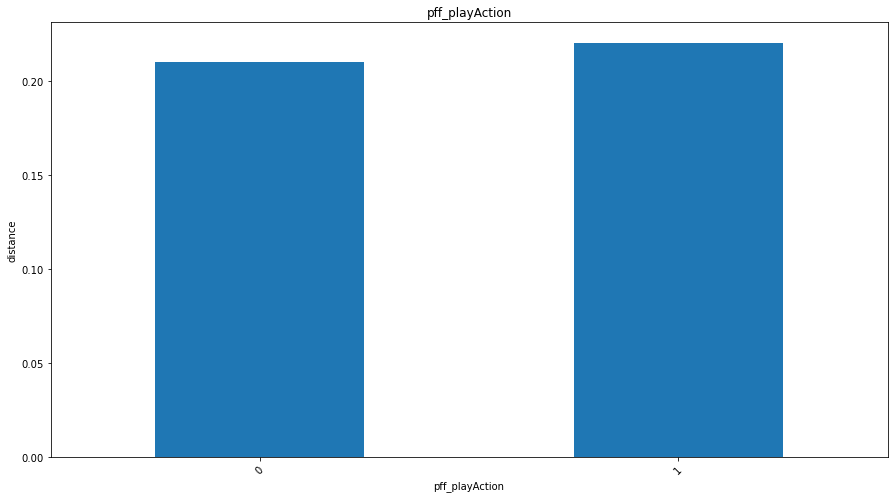

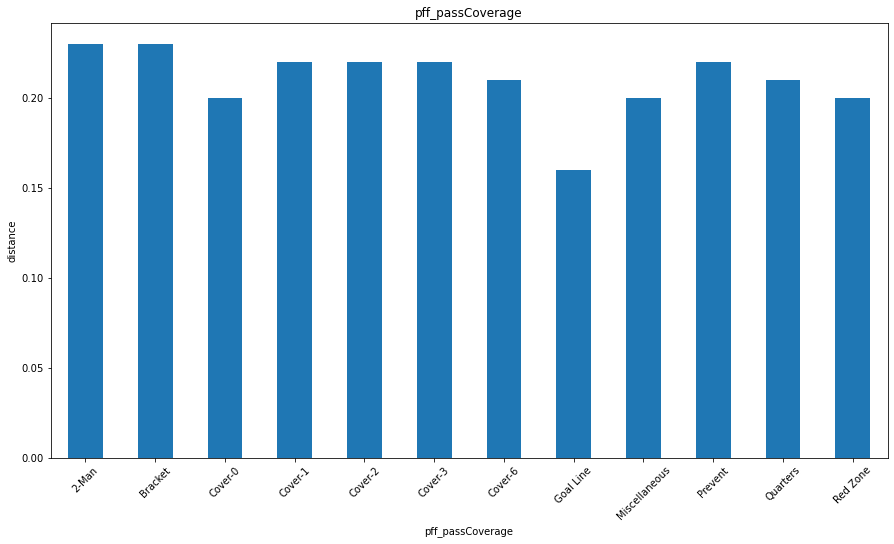

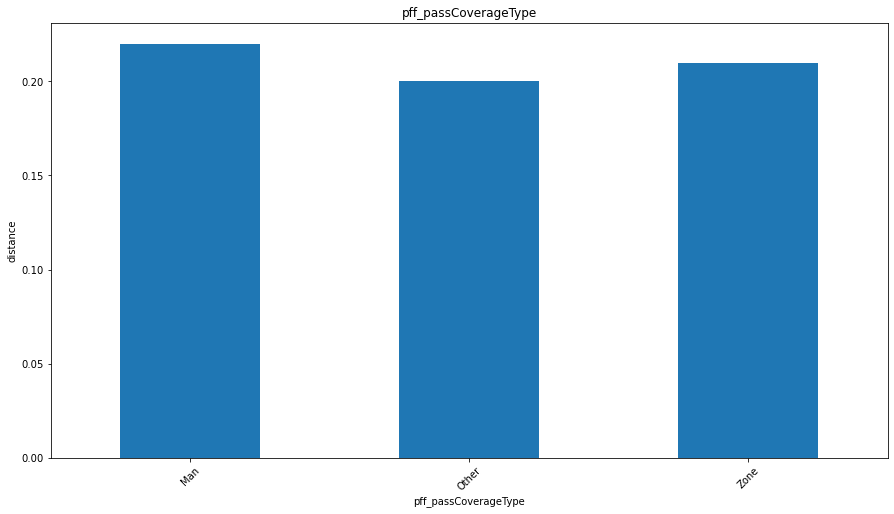

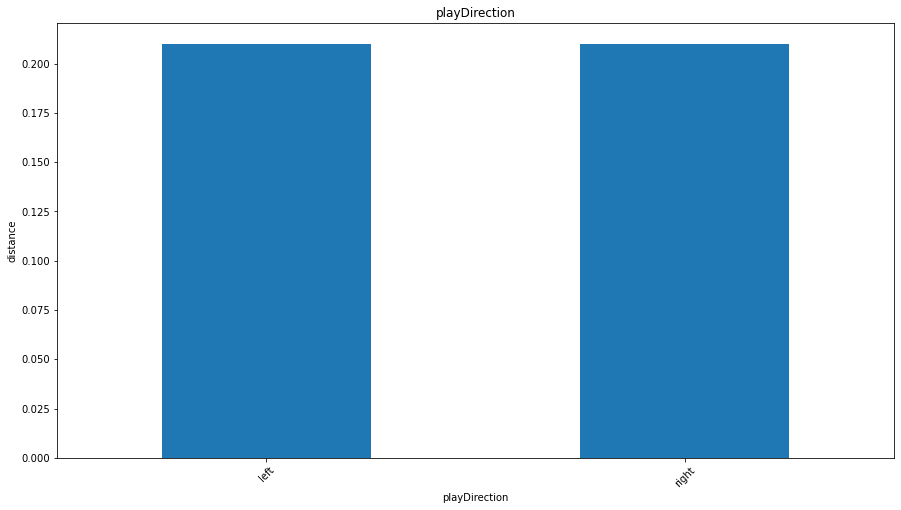

In [17]:
for col in col_with_finite:
    dfdis = df.copy()
    plt.figure(figsize = (15,8))
    dfacce.groupby(col)['dis'].median().plot.bar()
    plt.xlabel(col)
    plt.xticks(rotation=45)
    plt.ylabel('distance')
    plt.title(col)
    plt.savefig(f'{col}_dis.png')

## Numerical columns

In [6]:
numerical_col = [col for col in df.columns if df[col].dtypes != 'O']

In [7]:
numerical_col

['gameId',
 'season',
 'week',
 'playId',
 'nflId',
 'pff_hit',
 'pff_hurry',
 'pff_sack',
 'pff_beatenByDefender',
 'pff_hitAllowed',
 'pff_hurryAllowed',
 'pff_sackAllowed',
 'pff_nflIdBlockedPlayer',
 'pff_backFieldBlock',
 'weight',
 'quarter',
 'down',
 'yardsToGo',
 'yardlineNumber',
 'preSnapHomeScore',
 'preSnapVisitorScore',
 'penaltyYards',
 'prePenaltyPlayResult',
 'playResult',
 'foulNFLId1',
 'foulNFLId2',
 'foulNFLId3',
 'absoluteYardlineNumber',
 'defendersInBox',
 'pff_playAction',
 'frameId',
 'time',
 'jerseyNumber',
 'playDirection',
 'x',
 'y',
 's',
 'a',
 'dis',
 'o',
 'dir']

## Id, Date, Time cols

In [8]:
id_cols = [col for col in numerical_col if 'Id' in col or 'time' in col]

In [9]:
id_cols

['gameId',
 'playId',
 'nflId',
 'pff_nflIdBlockedPlayer',
 'foulNFLId1',
 'foulNFLId2',
 'foulNFLId3',
 'frameId',
 'time']

## continuous cols

In [16]:
contin_cols = [col for col in numerical_col if col not in col_with_finite]
continuos_cols = [col for col in contin_cols if col not in id_cols]

In [17]:
contin_cols

['gameId',
 'playId',
 'nflId',
 'pff_nflIdBlockedPlayer',
 'weight',
 'yardsToGo',
 'yardlineNumber',
 'preSnapHomeScore',
 'preSnapVisitorScore',
 'penaltyYards',
 'prePenaltyPlayResult',
 'playResult',
 'foulNFLId1',
 'foulNFLId2',
 'absoluteYardlineNumber',
 'frameId',
 'time',
 'jerseyNumber',
 'x',
 'y',
 's',
 'a',
 'dis',
 'o',
 'dir']

In [18]:
continuos_cols

['weight',
 'yardsToGo',
 'yardlineNumber',
 'preSnapHomeScore',
 'preSnapVisitorScore',
 'penaltyYards',
 'prePenaltyPlayResult',
 'playResult',
 'absoluteYardlineNumber',
 'jerseyNumber',
 'x',
 'y',
 's',
 'a',
 'dis',
 'o',
 'dir']

In [19]:
dfsample  = df.sample(frac=0.3)

In [20]:
dfsample.head()

,gameId,season,week,gameDate,gameTimeEastern,homeTeamAbbr,visitorTeamAbbr,playId,nflId,pff_role,pff_positionLinedUp,pff_hit,pff_hurry,pff_sack,pff_beatenByDefender,pff_hitAllowed,pff_hurryAllowed,pff_sackAllowed,pff_nflIdBlockedPlayer,pff_blockType,pff_backFieldBlock,height,weight,birthDate,collegeName,officialPosition,displayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,penaltyYards,prePenaltyPlayResult,playResult,foulName1,foulNFLId1,foulName2,foulNFLId2,foulName3,foulNFLId3,absoluteYardlineNumber,offenseFormation,personnelO,defendersInBox,personnelD,dropBackType,pff_playAction,pff_passCoverage,pff_passCoverageType,frameId,time,jerseyNumber,team,playDirection,x,y,s,a,dis,o,dir,event
5270668,2021091206,2021,1,09/12/2021,13:00:00,IND,SEA,2301,43291,Pass,QB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,6-5,237,1992-12-30,North Dakota State,QB,Carson Wentz,(7:56) (Shotgun) C.Wentz pass incomplete short...,3,1,10,IND,SEA,IND,15,07:56,10,21,I,NaN,0,0,None,NaN,None,NaN,None,NaN,25.0,EMPTY,"1 RB, 2 TE, 2 WR",7.0,"4 DL, 3 LB, 4 DB",TRADITIONAL,0,Cover-3,Zone,25,2021-09-12 19:00:34.600,2.0,IND,right,17.35,29.92,2.40,2.40,0.24,111.32,237.90,None
2724235,2021102403,2021,7,10/24/2021,13:00:00,NE,NYJ,2506,43433,Pass Block,C,NaN,NaN,NaN,0.0,0.0,0.0,0.0,44991.0,PP,0.0,6-4,306,1993-04-27,Missouri,C,Connor McGovern,(11:52) (Shotgun) M.White pass incomplete deep...,3,3,5,NYJ,NE,NE,28,11:52,31,7,I,9.0,0,9,Defensive Pass Interference,43522.0,None,NaN,None,NaN,38.0,EMPTY,"1 RB, 1 TE, 3 WR",5.0,"2 DL, 4 LB, 5 DB",None,0,Cover-1,Man,36,2021-10-24 18:52:18.500,60.0,NYJ,left,44.81,29.99,1.08,1.70,0.11,333.09,69.69,None
5892348,2021101708,2021,6,10/17/2021,16:05:00,CLE,ARI,1327,46235,Pass Block,RG,NaN,NaN,NaN,0.0,0.0,0.0,0.0,42427.0,PP,0.0,6-4,315,1994-11-21,Virginia Tech,G,Wyatt Teller,(14:02) (Shotgun) B.Mayfield sacked at CLE 15 ...,2,2,8,CLE,ARI,CLE,18,14:02,0,14,S,0.0,0,0,Offensive Holding,46235.0,None,NaN,None,NaN,92.0,EMPTY,"1 RB, 1 TE, 3 WR",6.0,"2 DL, 4 LB, 5 DB",SCRAMBLE,0,Cover-6,Zone,25,2021-10-17 20:54:11.800,77.0,CLE,left,95.12,24.94,1.65,1.72,0.17,261.82,155.21,None
4073944,2021100310,2021,4,10/03/2021,16:05:00,SF,SEA,2328,46156,Pass Rush,LEO,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,None,NaN,6-5,240,1996-05-03,Louisiana State,DE,Arden Key,(8:53) R.Wilson pass deep right to T.Lockett t...,3,1,10,SEA,SF,SEA,34,08:53,7,7,C,NaN,19,19,None,NaN,None,NaN,None,NaN,76.0,SINGLEBACK,"1 RB, 2 TE, 2 WR",8.0,"4 DL, 3 LB, 4 DB",TRADITIONAL,1,Cover-3,Zone,13,2021-10-03 21:57:35.200,98.0,SF,left,76.12,34.85,2.12,1.24,0.24,97.25,53.01,None
3626038,2021102400,2021,7,10/24/2021,13:00:00,BAL,CIN,3115,46123,Coverage,FSL,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,None,NaN,6-1,200,1997-02-26,Wake Forest,FS,Jessie Bates,(12:51) (Shotgun) L.Jackson scrambles up the m...,4,1,10,BAL,CIN,BAL,35,12:51,17,27,R,-10.0,39,-10,Offensive Holding,41222.0,None,NaN,None,NaN,75.0,SHOTGUN,"2 RB, 1 TE, 2 WR",6.0,"4 DL, 3 LB, 4 DB",None,0,Quarters,Zone,11,2021-10-24 19:35:22.600,30.0,CIN,left,61.92,33.21,0.83,1.08,0.08,111.76,322.16,None


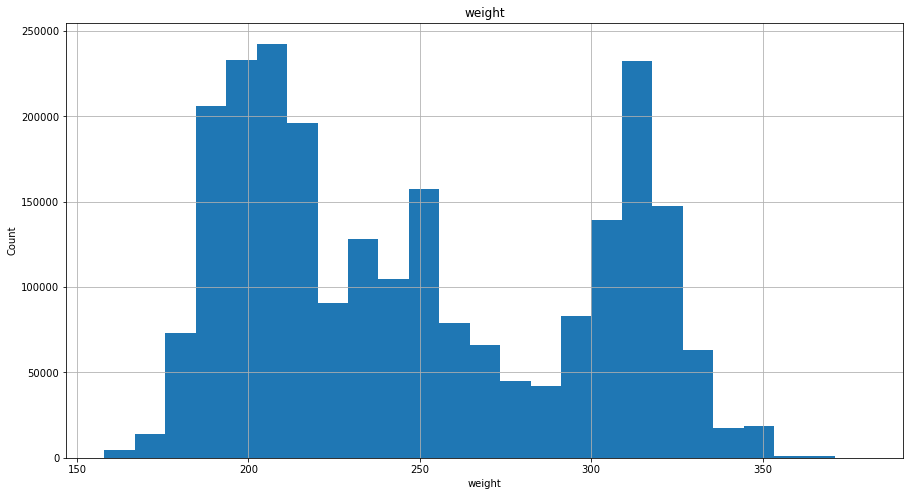

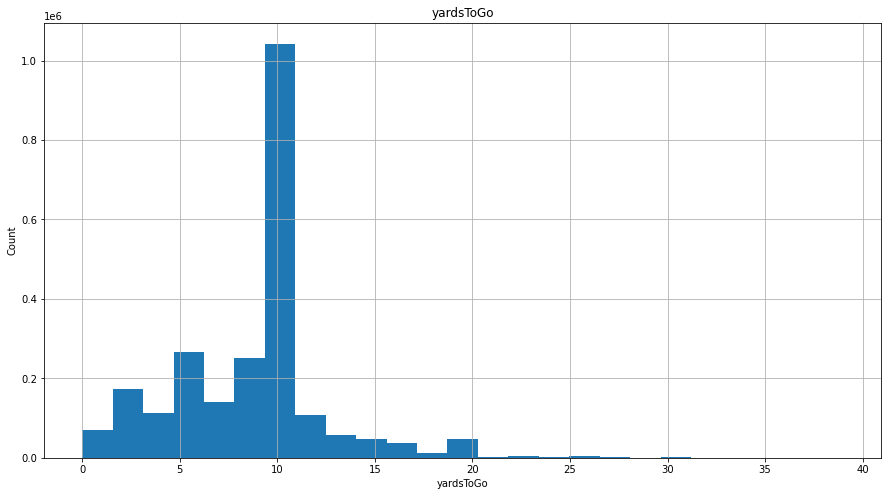

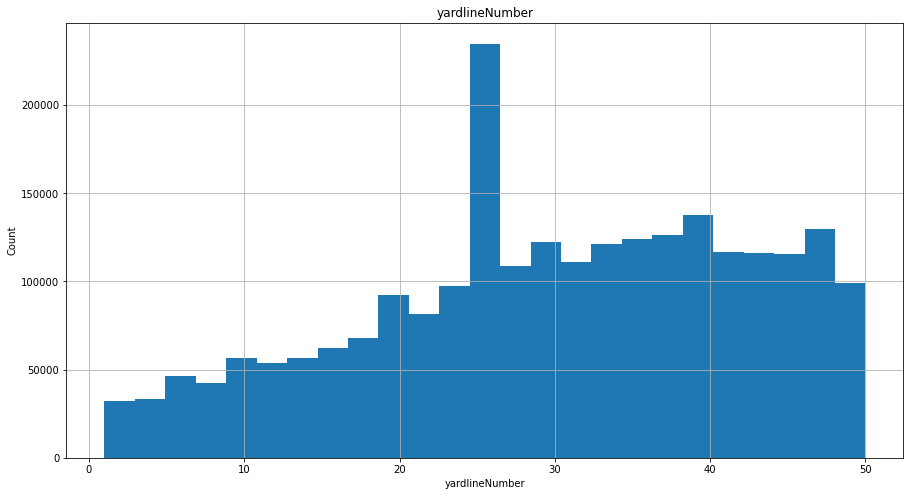

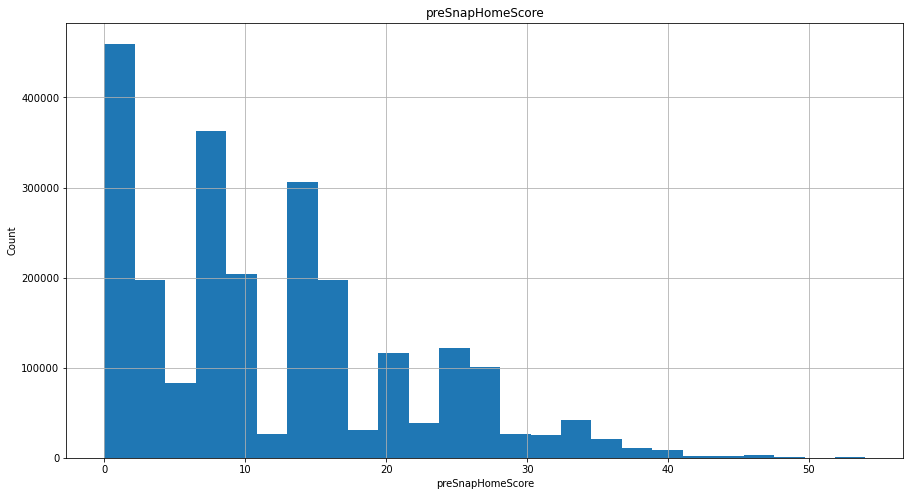

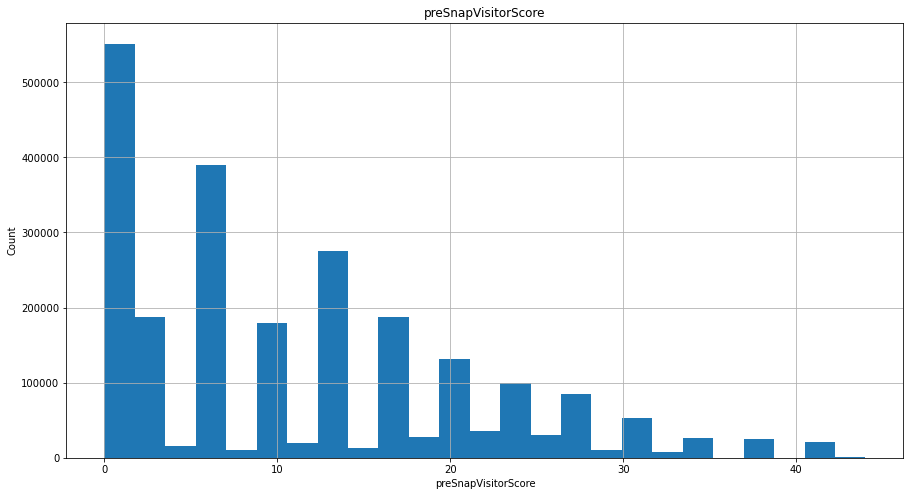

...

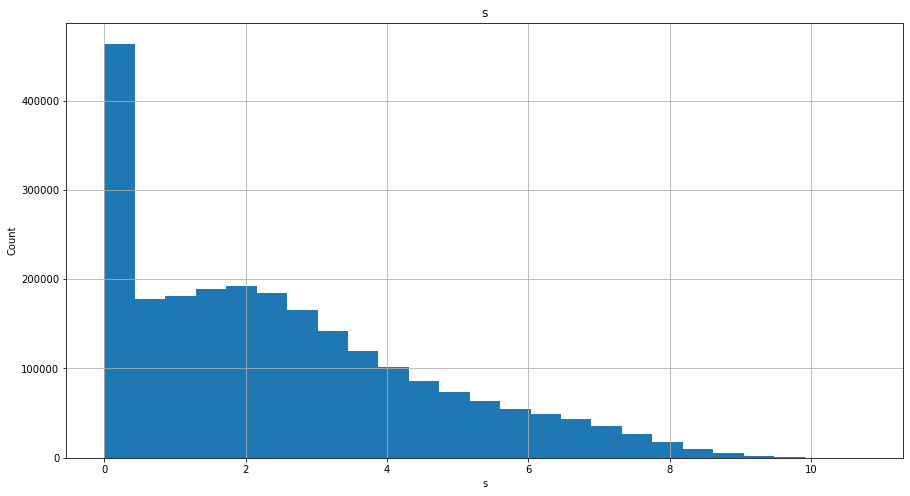

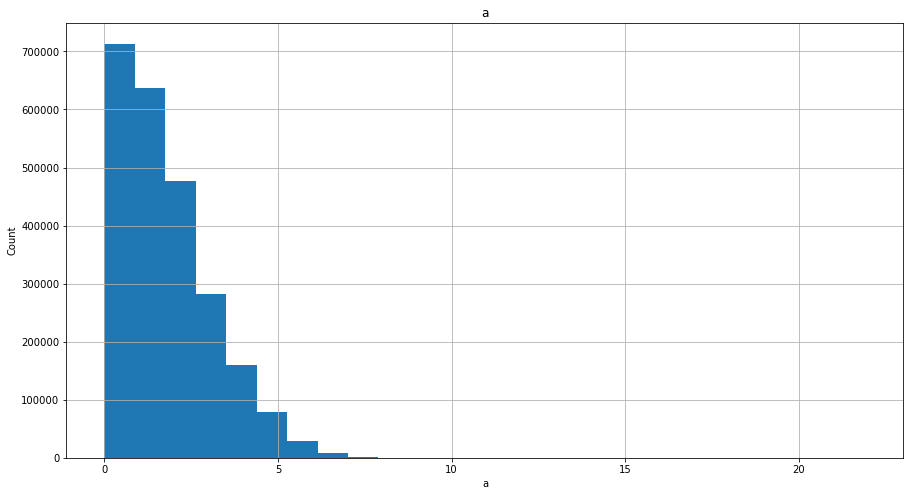

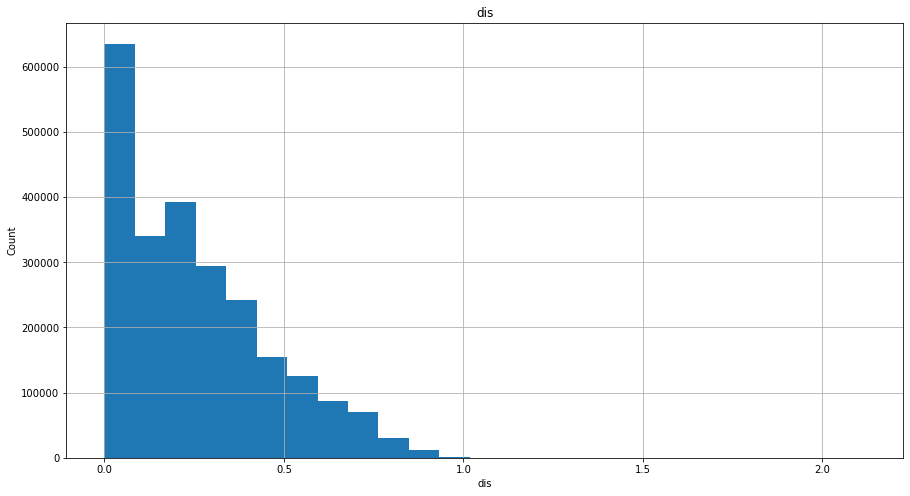

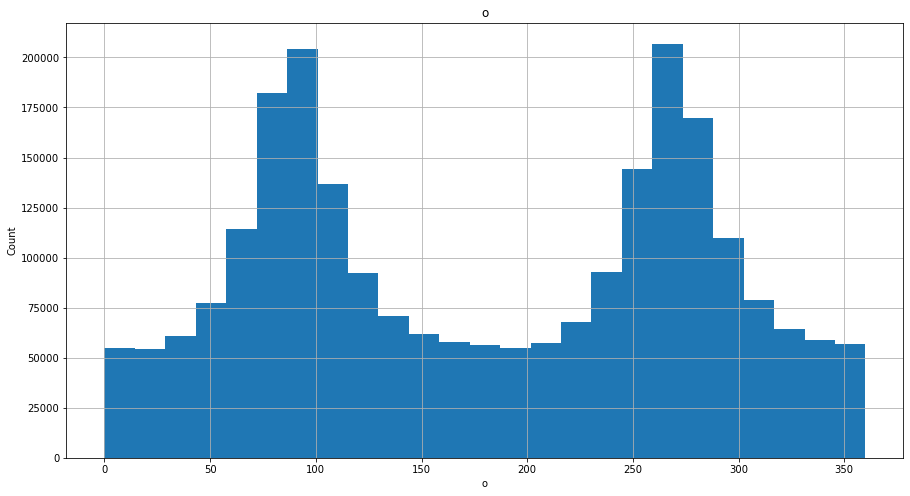

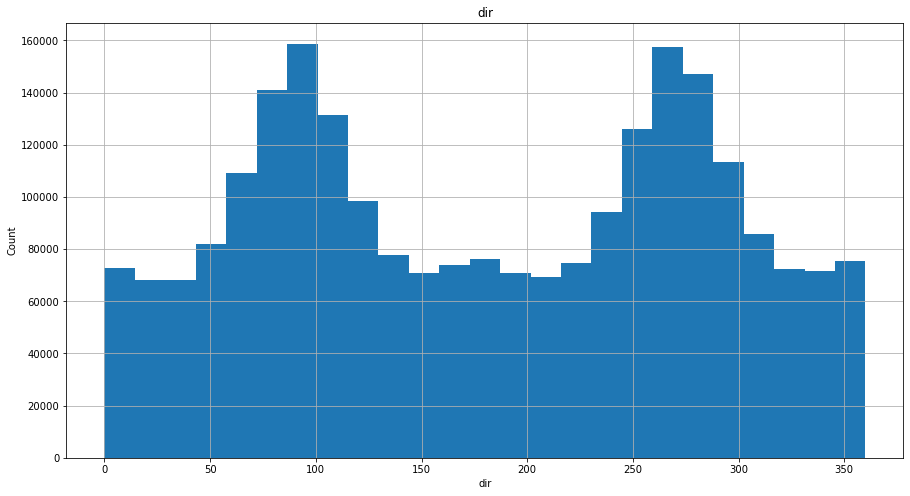

In [21]:
for col in continuos_cols:
    dfconti = dfsample.copy()
    plt.figure(figsize = (15,8))
    dfconti[col].hist(bins=25)
    plt.xlabel(col)
    plt.ylabel("Count")
    plt.title(col)
    plt.savefig(f'{col}.count.png')

In [27]:
continuos_cols.extend(('possessionTeam','defensiveTeam','collegeName','team','homeTeamAbbr','visitorTeamAbbr','displayName','officialPosition'))

In [28]:
continuos_cols

['weight',
 'yardsToGo',
 'yardlineNumber',
 'preSnapHomeScore',
 'preSnapVisitorScore',
 'penaltyYards',
 'prePenaltyPlayResult',
 'playResult',
 'absoluteYardlineNumber',
 'jerseyNumber',
 'x',
 'y',
 's',
 'a',
 'dis',
 'o',
 'dir',
 'possessionTeam',
 'defensiveTeam',
 'collegeName',
 'team',
 'homeTeamAbbr',
 'visitorTeamAbbr',
 'displayName',
 'officialPosition']

In [30]:
dffresh = df[continuos_cols]
dffresh.head()

,weight,yardsToGo,yardlineNumber,preSnapHomeScore,preSnapVisitorScore,penaltyYards,prePenaltyPlayResult,playResult,absoluteYardlineNumber,jerseyNumber,x,y,s,a,dis,o,dir,possessionTeam,defensiveTeam,collegeName,team,homeTeamAbbr,visitorTeamAbbr,displayName,officialPosition
0,225,2,33,0,0,NaN,0,0,43.0,12.0,37.77,24.22,0.29,0.30,0.03,165.16,84.99,TB,DAL,Michigan,TB,TB,DAL,Tom Brady,QB
1,225,2,33,0,0,NaN,0,0,43.0,12.0,37.78,24.22,0.23,0.11,0.02,164.33,92.87,TB,DAL,Michigan,TB,TB,DAL,Tom Brady,QB
2,225,2,33,0,0,NaN,0,0,43.0,12.0,37.78,24.24,0.16,0.10,0.01,160.24,68.55,TB,DAL,Michigan,TB,TB,DAL,Tom Brady,QB
3,225,2,33,0,0,NaN,0,0,43.0,12.0,37.73,24.25,0.15,0.24,0.06,152.13,296.85,TB,DAL,Michigan,TB,TB,DAL,Tom Brady,QB
4,225,2,33,0,0,NaN,0,0,43.0,12.0,37.69,24.26,0.25,0.18,0.04,148.33,287.55,TB,DAL,Michigan,TB,TB,DAL,Tom Brady,QB


In [35]:
dffresh.iloc[::, 1:9]

,yardsToGo,yardlineNumber,preSnapHomeScore,preSnapVisitorScore,penaltyYards,prePenaltyPlayResult,playResult,absoluteYardlineNumber
0,2,33,0,0,NaN,0,0,43.0
1,2,33,0,0,NaN,0,0,43.0
2,2,33,0,0,NaN,0,0,43.0
3,2,33,0,0,NaN,0,0,43.0
4,2,33,0,0,NaN,0,0,43.0
...,...,...,...,...,...,...,...,...
7952687,7,33,27,27,NaN,-6,-6,43.0
7952688,7,33,27,27,NaN,-6,-6,43.0
7952689,7,33,27,27,NaN,-6,-6,43.0
7952690,7,33,27,27,NaN,-6,-6,43.0


In [36]:
dffresh.nunique()

weight                      176
yardsToGo                    32
yardlineNumber               50
preSnapHomeScore             42
preSnapVisitorScore          38
penaltyYards                 60
prePenaltyPlayResult         98
playResult                  102
absoluteYardlineNumber       99
jerseyNumber                 99
x                         12069
y                          5683
s                          1066
a                          1165
dis                         162
o                         36001
dir                       36001
possessionTeam               32
defensiveTeam                32
collegeName                 236
team                         32
homeTeamAbbr                 32
visitorTeamAbbr              32
displayName                1671
officialPosition             19
dtype: int64

In [37]:
dffresh.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
weight,7952692.0,NaN,NaN,NaN,248.71497,49.286846,158.0,205.0,238.0,305.0,380.0
yardsToGo,7952692.0,NaN,NaN,NaN,8.772437,3.916289,0.0,6.0,10.0,10.0,39.0
yardlineNumber,7952692.0,NaN,NaN,NaN,29.999707,12.503715,1.0,22.0,31.0,40.0,50.0
preSnapHomeScore,7952692.0,NaN,NaN,NaN,11.657718,9.789984,0.0,3.0,10.0,17.0,54.0
preSnapVisitorScore,7952692.0,NaN,NaN,NaN,11.290941,10.005634,0.0,3.0,10.0,17.0,44.0
penaltyYards,776380.0,NaN,NaN,NaN,3.294361,11.78737,-18.0,-5.0,2.0,11.0,50.0
prePenaltyPlayResult,7952692.0,NaN,NaN,NaN,6.285906,10.601885,-34.0,0.0,3.0,10.0,91.0
playResult,7952692.0,NaN,NaN,NaN,6.325791,11.038514,-34.0,0.0,4.0,11.0,91.0
absoluteYardlineNumber,7951900.0,NaN,NaN,NaN,59.251022,23.576197,11.0,40.0,59.0,78.0,109.0
jerseyNumber,7952692.0,NaN,NaN,NaN,49.701165,29.91778,1.0,23.0,52.0,75.0,99.0


In [38]:
dffresh.duplicated().sum()

333

In [39]:
df.duplicated().sum()

0

In [40]:
dffresh.groupby(['team']).mean()

,weight,yardsToGo,yardlineNumber,preSnapHomeScore,preSnapVisitorScore,penaltyYards,prePenaltyPlayResult,playResult,absoluteYardlineNumber,jerseyNumber,x,y,s,a,dis,o,dir
team,,,,,,,,,,,,,,,,,
ARI,244.586906,8.980622,29.959717,10.649292,14.337897,2.404947,6.513181,6.625798,59.088105,42.679472,58.668764,26.435009,2.581278,1.773338,0.258600,176.315586,182.521937
ATL,248.563027,8.550471,29.737597,12.299810,10.206154,3.980894,6.197568,6.416624,62.300367,47.458448,62.728344,26.875163,2.462679,1.780118,0.246938,183.761355,180.993502
BAL,250.825106,9.283390,31.095949,9.809140,13.523241,1.445395,7.209080,7.042154,58.212975,49.456076,58.006226,26.872144,2.561526,1.777892,0.257150,179.876503,180.352265
BUF,245.709495,8.599326,29.893612,10.866275,10.797521,0.764872,5.830873,5.643111,58.036495,48.038670,57.902095,26.521054,2.560096,1.694638,0.258959,176.136534,179.639329
CAR,247.990696,8.760033,30.312323,11.325470,7.574117,2.287215,5.548337,5.452952,58.754189,46.067035,58.757811,26.944797,2.569259,1.769453,0.258870,186.323474,180.939524
CHI,249.576096,9.112321,30.958867,12.438012,5.926500,5.942352,5.361719,5.498314,59.472883,49.360834,59.561410,26.662139,2.533438,1.778825,0.254326,180.689887,179.452863
CIN,250.640106,8.772160,31.081072,8.685311,12.727617,2.161829,6.745271,6.549567,59.112476,54.915977,58.440999,26.579003,2.456871,1.737397,0.247002,174.157336,182.294895
CLE,246.280656,8.781533,29.642244,10.573823,11.374654,3.985101,5.476916,5.518744,57.768744,52.138181,57.844437,26.517587,2.509741,1.751313,0.252644,179.999786,180.293749
DAL,248.514348,8.760335,29.527463,16.263868,11.473084,1.083583,7.416108,6.758421,60.860522,49.282838,60.531082,26.950289,2.477974,1.679526,0.249217,177.260757,182.128127


In [41]:
dffresh.groupby(['team']).median()

,weight,yardsToGo,yardlineNumber,preSnapHomeScore,preSnapVisitorScore,penaltyYards,prePenaltyPlayResult,playResult,absoluteYardlineNumber,jerseyNumber,x,y,s,a,dis,o,dir
team,,,,,,,,,,,,,,,,,
ARI,233.0,10.0,30.0,10.0,10.0,0.0,4.0,4.0,58.0,42.0,56.930,26.29,2.21,1.52,0.22,168.790,184.340
ATL,240.0,10.0,30.0,10.0,7.0,2.0,4.0,5.0,63.0,45.0,63.420,26.88,2.13,1.54,0.21,187.910,179.450
BAL,240.0,10.0,32.0,7.0,14.0,0.0,4.0,4.0,57.0,49.0,57.060,26.85,2.12,1.53,0.21,176.880,181.125
BUF,240.0,10.0,31.0,10.0,7.0,0.0,3.0,3.0,57.0,49.0,56.920,26.46,2.19,1.48,0.22,165.525,177.650
CAR,230.0,10.0,31.0,10.0,6.0,5.0,0.0,1.0,59.0,43.0,58.350,26.97,2.16,1.52,0.22,197.600,179.885
CHI,235.0,10.0,33.0,10.0,3.0,5.0,2.0,4.0,60.0,52.0,60.200,26.66,2.16,1.54,0.22,183.475,177.520
CIN,245.0,10.0,32.0,7.0,10.0,0.0,4.0,4.0,58.0,65.0,58.150,26.54,2.11,1.51,0.21,159.300,184.110
CLE,230.0,10.0,30.0,10.0,8.0,0.0,0.0,1.0,57.0,56.0,57.265,26.35,2.15,1.54,0.22,184.640,179.960
DAL,242.0,10.0,31.0,14.0,13.0,0.0,5.0,5.0,61.0,52.0,60.830,27.04,2.05,1.44,0.21,164.510,182.390


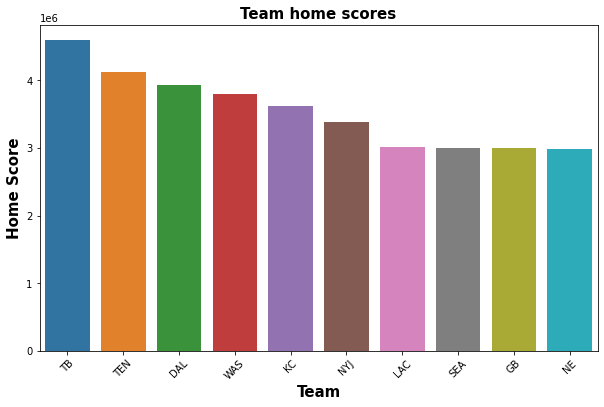

In [42]:
plt.figure(figsize=(10,6))
sns.barplot(y=dffresh.groupby('team')['preSnapHomeScore'].sum().sort_values(ascending=False)[:10],
            x=dffresh.groupby('team')['preSnapHomeScore'].sum().sort_values(ascending=False).index[:10])
plt.ylabel('Home Score',fontsize=15, fontweight='bold')
plt.xlabel("Team",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("Team home scores",fontsize=15, fontweight='bold')
plt.show()

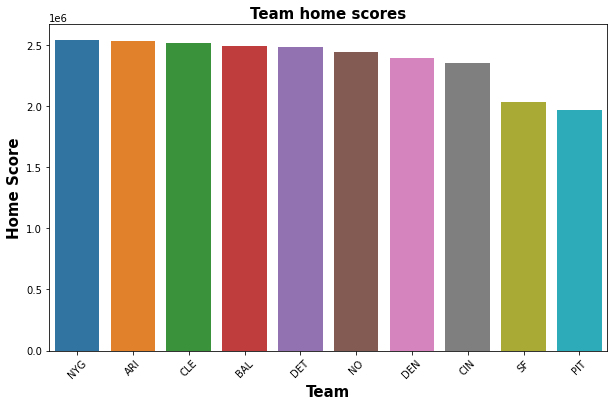

In [49]:
plt.figure(figsize=(10,6))
sns.barplot(y=dffresh.groupby('team')['preSnapHomeScore'].sum().sort_values(ascending=False)[-10:],
            x=dffresh.groupby('team')['preSnapHomeScore'].sum().sort_values(ascending=False).index[-10:])
plt.ylabel('Home Score',fontsize=15, fontweight='bold')
plt.xlabel("Team",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("Team home scores",fontsize=15, fontweight='bold')
plt.show()

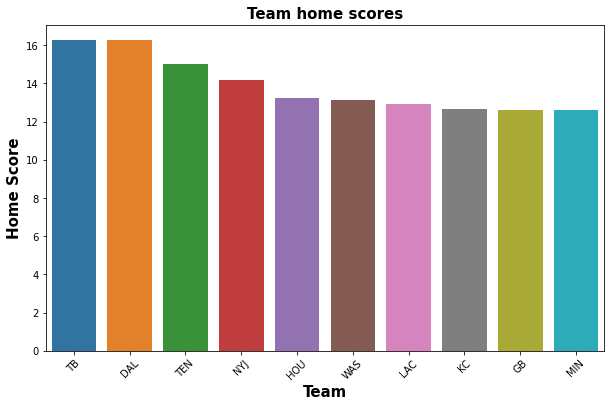

In [45]:
plt.figure(figsize=(10,6))
sns.barplot(y=dffresh.groupby('team')['preSnapHomeScore'].mean().sort_values(ascending=False)[:10],
            x=dffresh.groupby('team')['preSnapHomeScore'].mean().sort_values(ascending=False).index[:10])
plt.ylabel('Home Score',fontsize=15, fontweight='bold')
plt.xlabel("Team",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("Team home scores",fontsize=15, fontweight='bold')
plt.show()

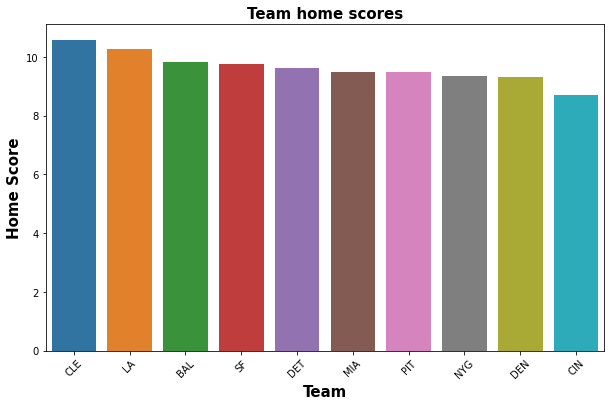

In [50]:
plt.figure(figsize=(10,6))
sns.barplot(y=dffresh.groupby('team')['preSnapHomeScore'].mean().sort_values(ascending=False)[-10:],
            x=dffresh.groupby('team')['preSnapHomeScore'].mean().sort_values(ascending=False).index[-10:])
plt.ylabel('Home Score',fontsize=15, fontweight='bold')
plt.xlabel("Team",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("Team home scores",fontsize=15, fontweight='bold')
plt.show()

In [43]:
dffresh.groupby('team')['preSnapHomeScore'].sum().sort_values(ascending=False)[:10]

team
TB     4591433
TEN    4123559
DAL    3924943
WAS    3797508
KC     3617119
NYJ    3376186
LAC    3011305
SEA    3002879
GB     2994255
NE     2990427
Name: preSnapHomeScore, dtype: int64

In [44]:
dffresh.groupby('team')['preSnapHomeScore'].mean().sort_values(ascending=False)[:10]

team
TB     16.270484
DAL    16.263868
TEN    15.004963
NYJ    14.195736
HOU    13.236771
WAS    13.153046
LAC    12.933103
KC     12.641435
GB     12.635427
MIN    12.599501
Name: preSnapHomeScore, dtype: float64

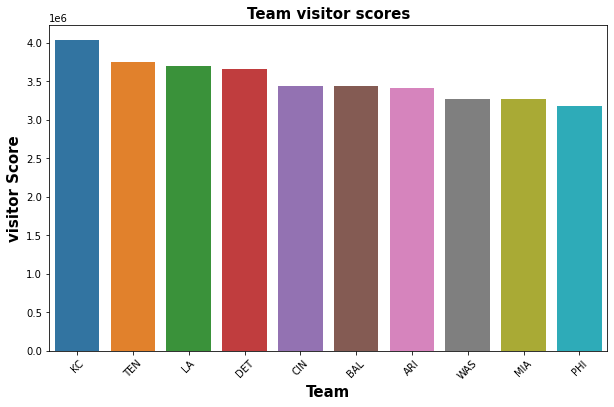

In [46]:
plt.figure(figsize=(10,6))
sns.barplot(y=dffresh.groupby('team')['preSnapVisitorScore'].sum().sort_values(ascending=False)[:10],
            x=dffresh.groupby('team')['preSnapVisitorScore'].sum().sort_values(ascending=False).index[:10])
plt.ylabel('visitor Score',fontsize=15, fontweight='bold')
plt.xlabel("Team",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("Team visitor scores",fontsize=15, fontweight='bold')
plt.show()

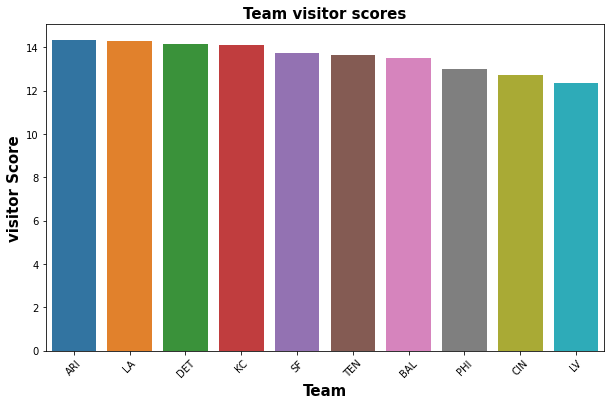

In [47]:
plt.figure(figsize=(10,6))
sns.barplot(y=dffresh.groupby('team')['preSnapVisitorScore'].mean().sort_values(ascending=False)[:10],
            x=dffresh.groupby('team')['preSnapVisitorScore'].mean().sort_values(ascending=False).index[:10])
plt.ylabel('visitor Score',fontsize=15, fontweight='bold')
plt.xlabel("Team",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("Team visitor scores",fontsize=15, fontweight='bold')
plt.show()

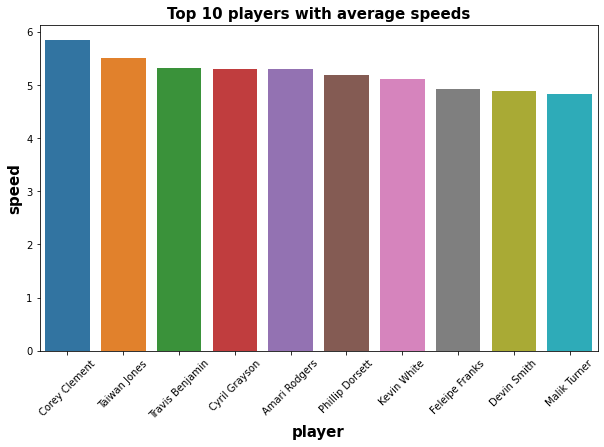

In [52]:
plt.figure(figsize=(10,6))
sns.barplot(y=dffresh.groupby('displayName')['s'].mean().sort_values(ascending=False)[:10],
            x=dffresh.groupby('displayName')['s'].mean().sort_values(ascending=False).index[:10])
plt.ylabel('speed',fontsize=15, fontweight='bold')
plt.xlabel("player",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("Top 10 players with average speeds",fontsize=15, fontweight='bold')
plt.show()

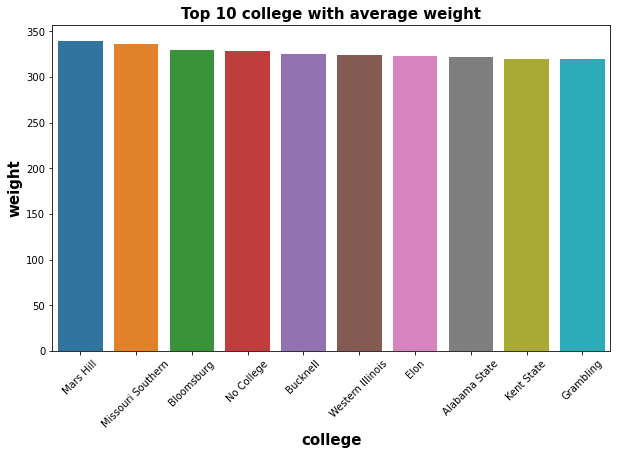

In [54]:
plt.figure(figsize=(10,6))
sns.barplot(y=dffresh.groupby('collegeName')['weight'].mean().sort_values(ascending=False)[:10],
            x=dffresh.groupby('collegeName')['weight'].mean().sort_values(ascending=False).index[:10])
plt.ylabel('weight',fontsize=15, fontweight='bold')
plt.xlabel("college",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("Top 10 college with average weight",fontsize=15, fontweight='bold')
plt.show()

In [55]:
contin_cols

['gameId',
 'playId',
 'nflId',
 'pff_nflIdBlockedPlayer',
 'weight',
 'yardsToGo',
 'yardlineNumber',
 'preSnapHomeScore',
 'preSnapVisitorScore',
 'penaltyYards',
 'prePenaltyPlayResult',
 'playResult',
 'foulNFLId1',
 'foulNFLId2',
 'absoluteYardlineNumber',
 'frameId',
 'time',
 'jerseyNumber',
 'x',
 'y',
 's',
 'a',
 'dis',
 'o',
 'dir']

In [56]:
num_cols = [col for col in contin_cols if col not in id_cols]

In [69]:
len(num_cols)

17

In [59]:
cat_cols = [col for col in df.columns if col not in numerical_col]

In [71]:
cat_cols.remove('gameDate')

In [72]:
cat_cols.remove('gameTimeEastern')

In [73]:
cat_colsx = [col for col in cat_cols if col not in id_cols]

In [74]:
len(cat_colsx)

27

Error: groupby_pff_roleweight.png
Error: groupby_pff_roleyardsToGo.png
Error: groupby_pff_roleyardlineNumber.png
Error: groupby_pff_rolepreSnapHomeScore.png
Error: groupby_pff_rolepreSnapVisitorScore.png
Error: groupby_pff_rolepenaltyYards.png
Error: groupby_pff_roleprePenaltyPlayResult.png
Error: groupby_pff_roleplayResult.png
Error: groupby_pff_roleabsoluteYardlineNumber.png
Error: groupby_pff_rolejerseyNumber.png
Error: groupby_pff_rolex.png
Error: groupby_pff_roley.png
Error: groupby_pff_roles.png
Error: groupby_pff_rolea.png
Error: groupby_pff_roledis.png
Error: groupby_pff_roleo.png
Error: groupby_pff_roledir.png
Error: groupby_pff_positionLinedUpweight.png
Error: groupby_pff_positionLinedUpyardsToGo.png
Error: groupby_pff_positionLinedUpyardlineNumber.png
Error: groupby_pff_positionLinedUppreSnapHomeScore.png
Error: groupby_pff_positionLinedUppreSnapVisitorScore.png
Error: groupby_pff_positionLinedUppenaltyYards.png
Error: groupby_pff_positionLinedUpprePenaltyPlayResult.png
Erro

Error: groupby_dropBackTypeplayResult.png
Error: groupby_dropBackTypeabsoluteYardlineNumber.png
Error: groupby_dropBackTypejerseyNumber.png
Error: groupby_dropBackTypex.png
Error: groupby_dropBackTypey.png
Error: groupby_dropBackTypes.png
Error: groupby_dropBackTypea.png
Error: groupby_dropBackTypedis.png
Error: groupby_dropBackTypeo.png
Error: groupby_dropBackTypedir.png
Error: groupby_pff_passCoverageweight.png
Error: groupby_pff_passCoverageyardsToGo.png
Error: groupby_pff_passCoverageyardlineNumber.png
Error: groupby_pff_passCoveragepreSnapHomeScore.png
Error: groupby_pff_passCoveragepreSnapVisitorScore.png
Error: groupby_pff_passCoveragepenaltyYards.png
Error: groupby_pff_passCoverageprePenaltyPlayResult.png
Error: groupby_pff_passCoverageplayResult.png
Error: groupby_pff_passCoverageabsoluteYardlineNumber.png
Error: groupby_pff_passCoveragejerseyNumber.png
Error: groupby_pff_passCoveragex.png
Error: groupby_pff_passCoveragey.png
Error: groupby_pff_passCoverages.png
Error: groupby

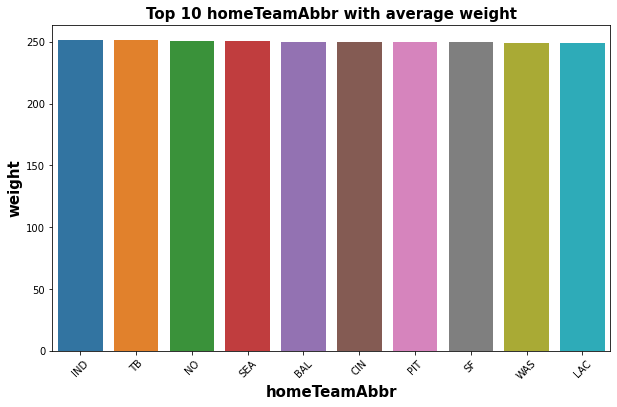

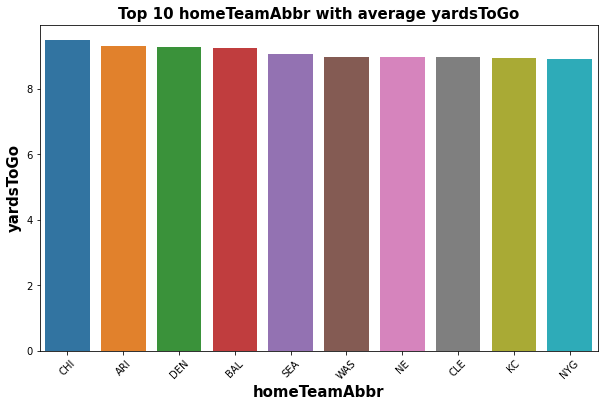

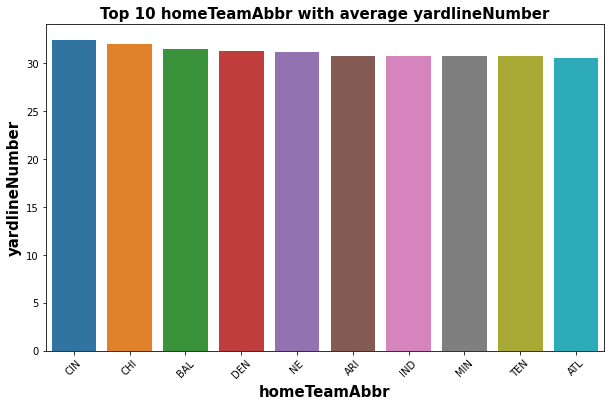

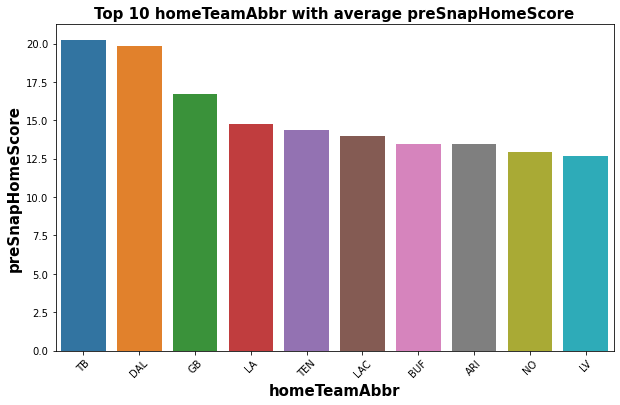

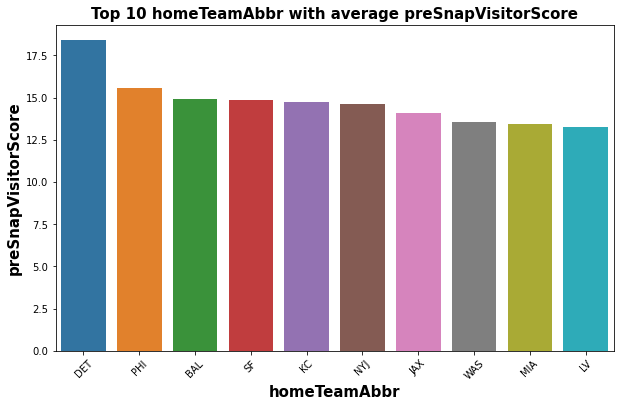

...

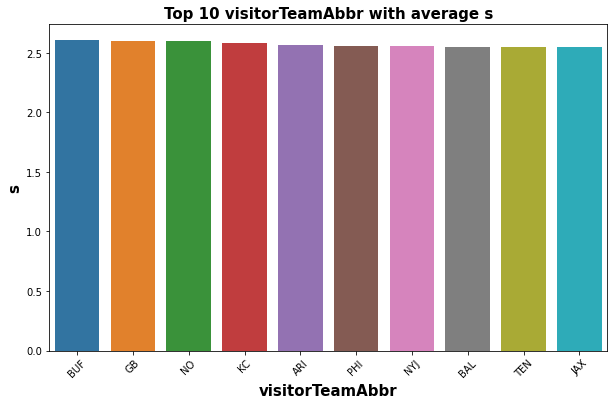

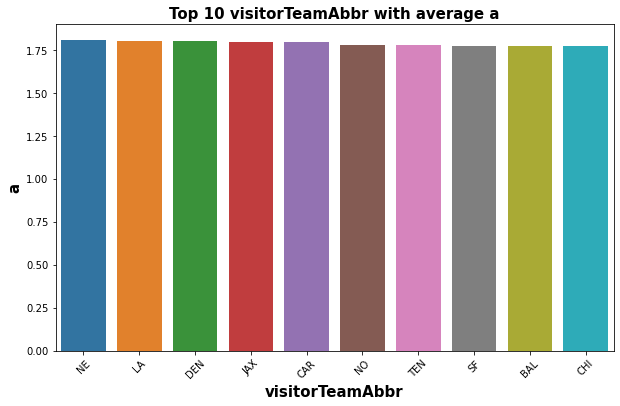

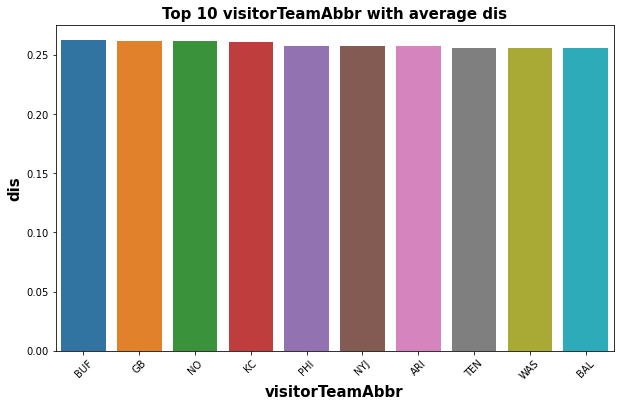

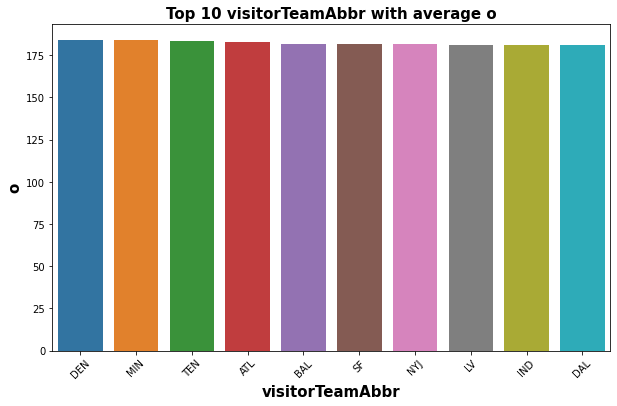

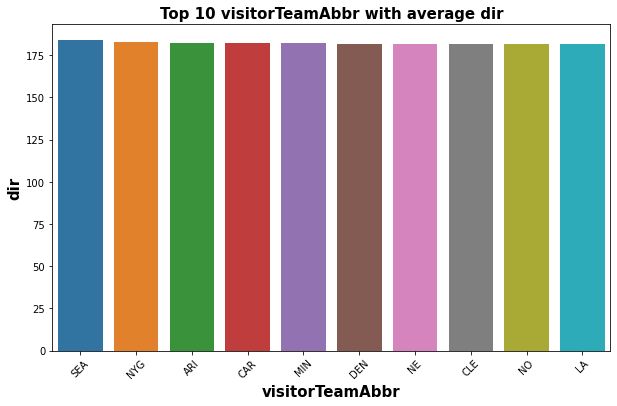

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

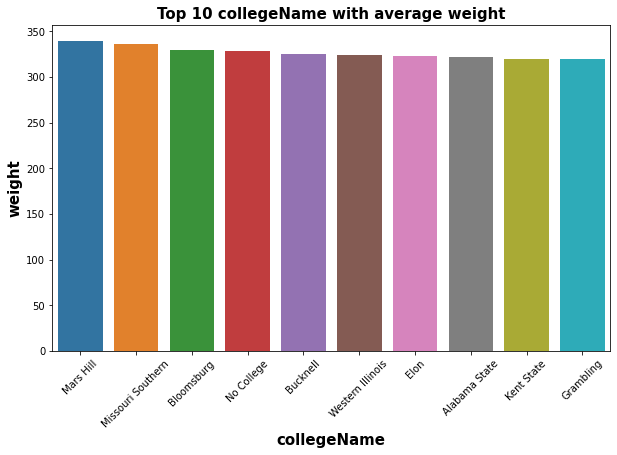

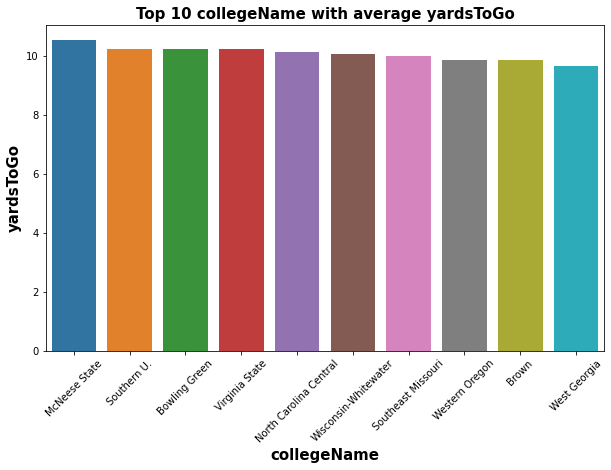

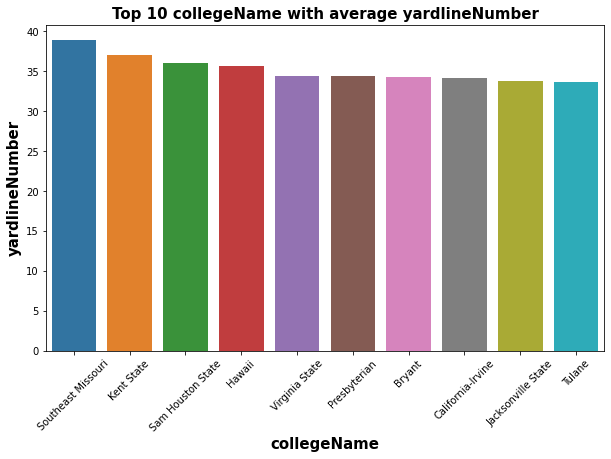

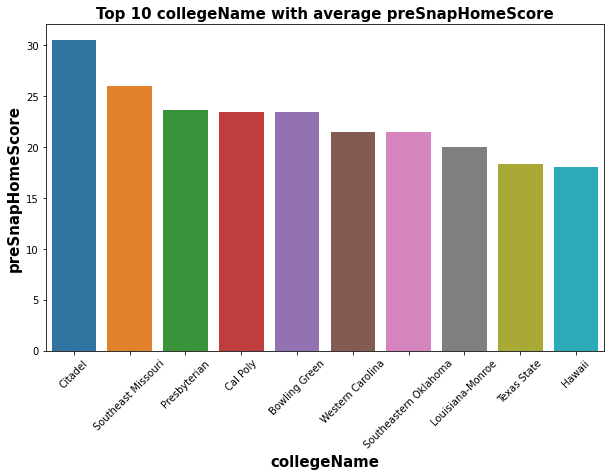

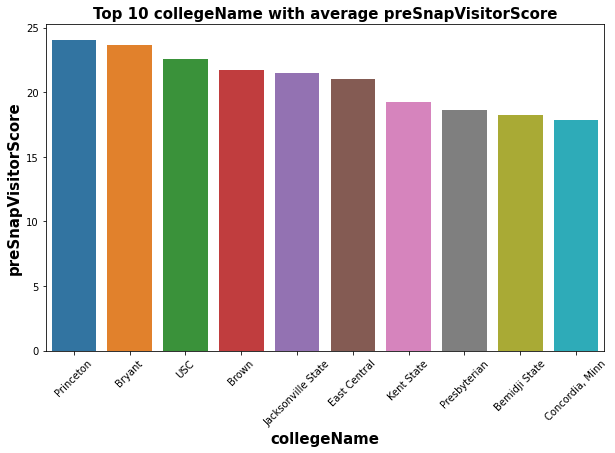

...

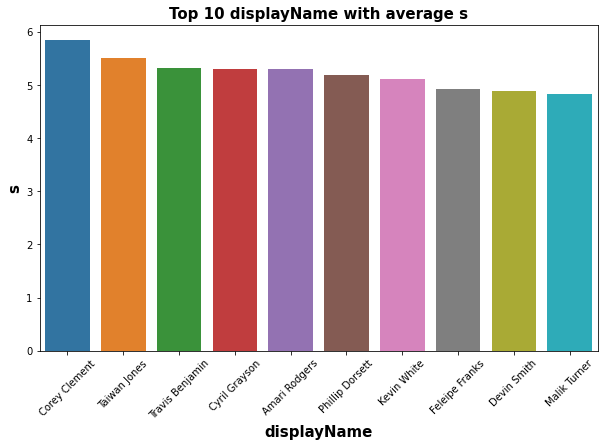

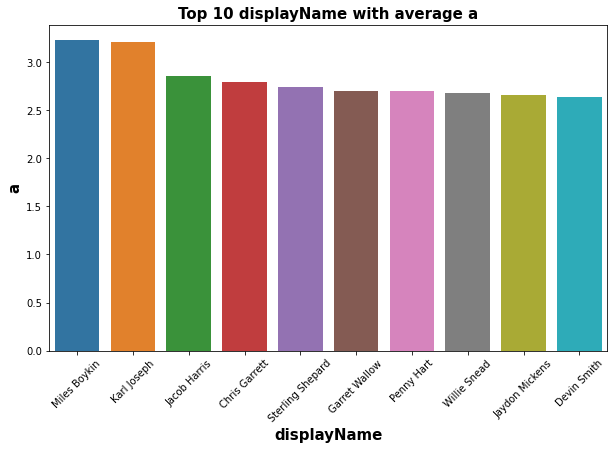

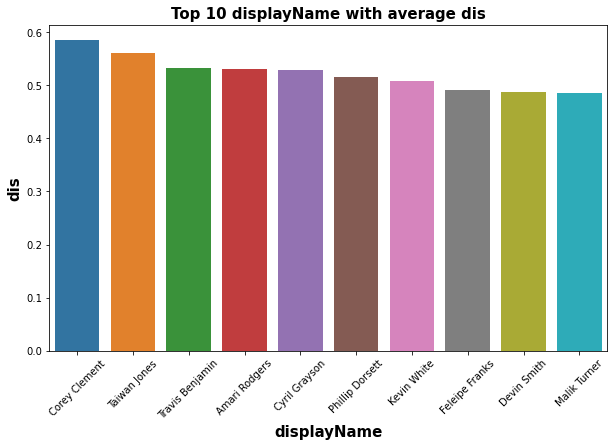

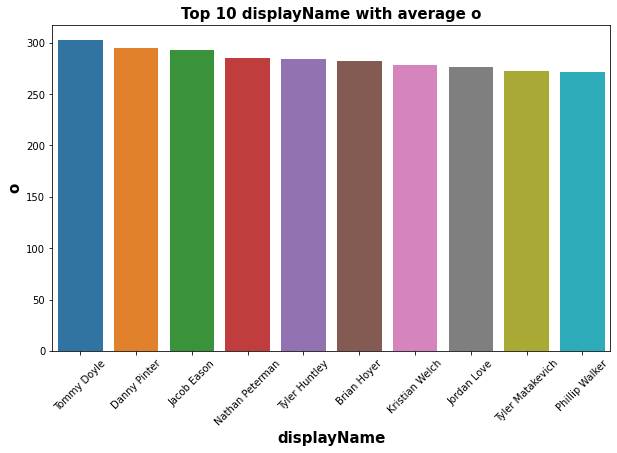

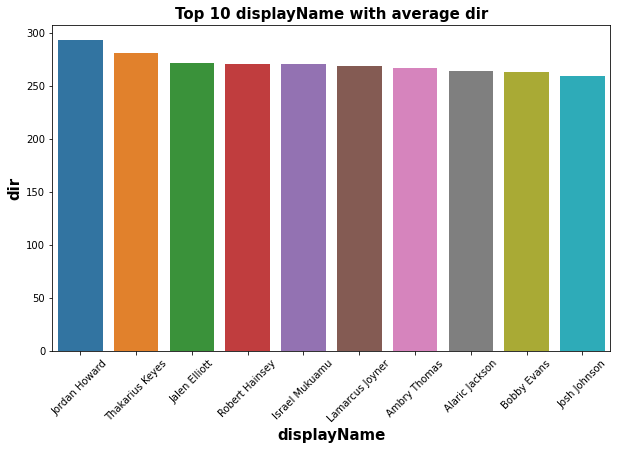

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

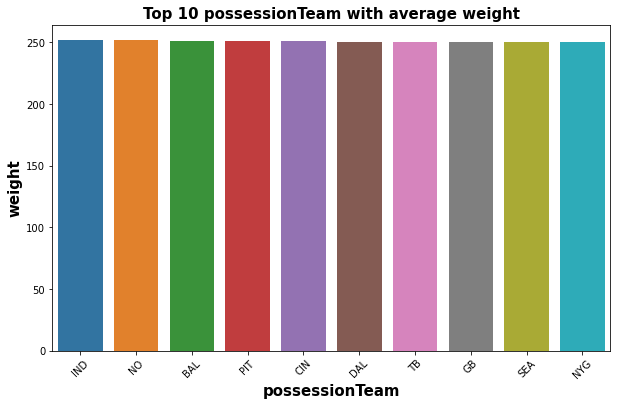

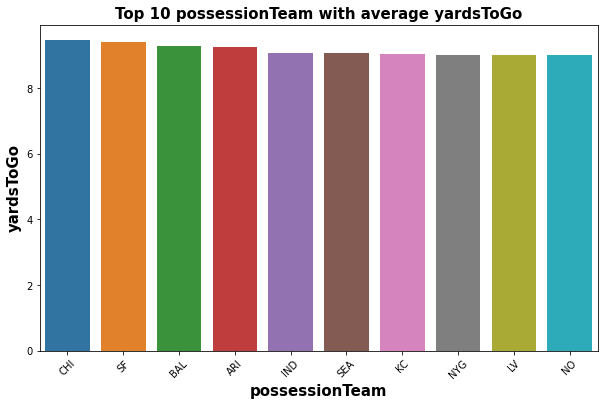

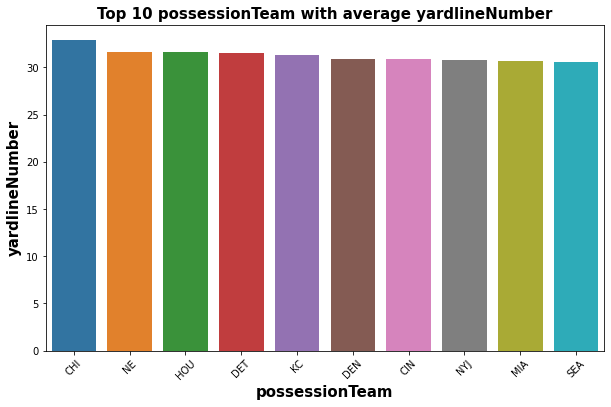

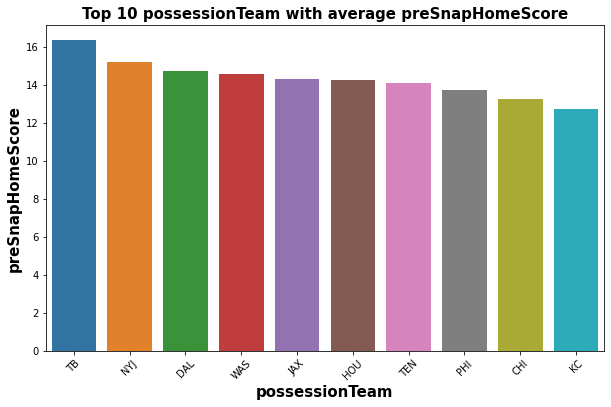

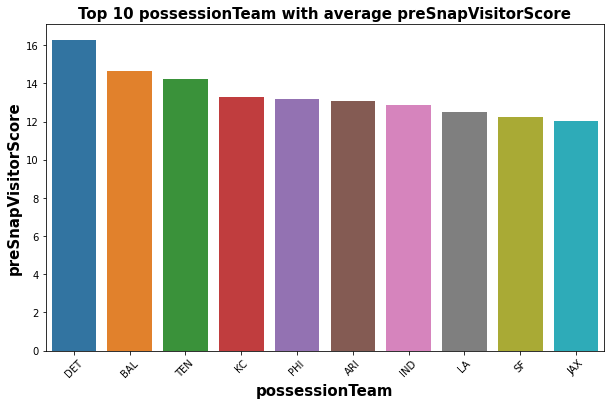

...

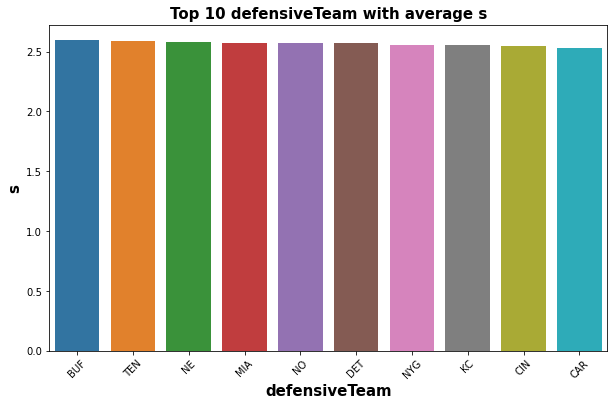

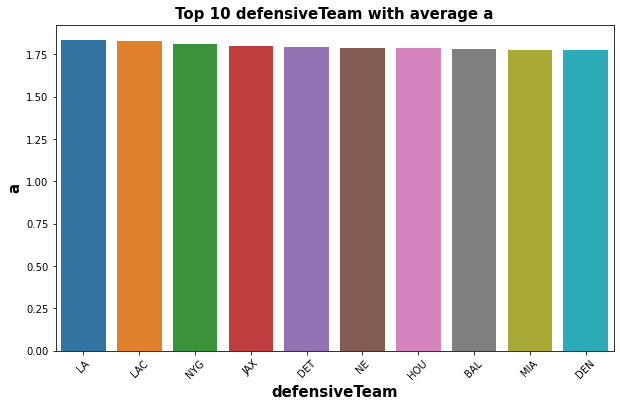

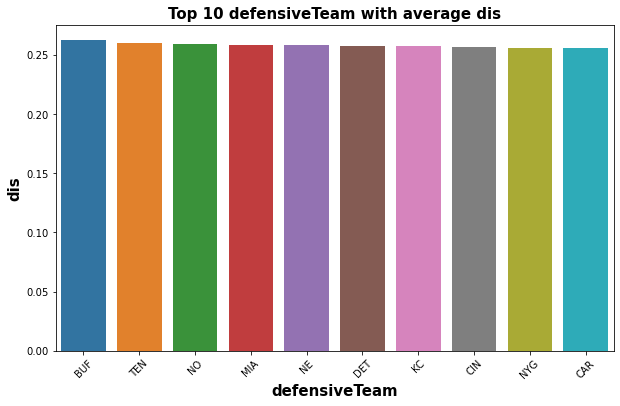

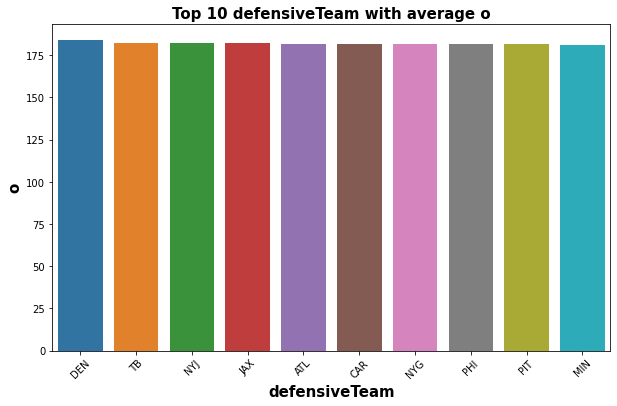

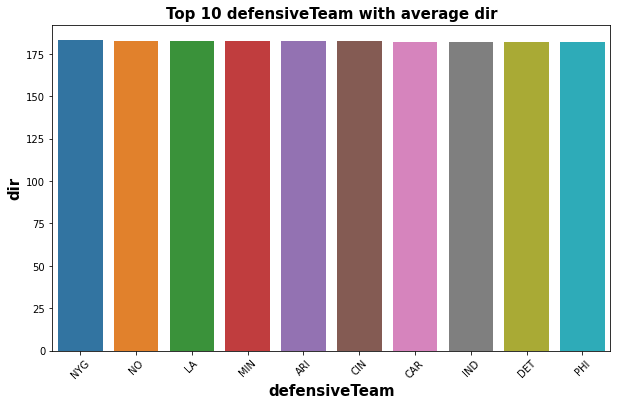

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

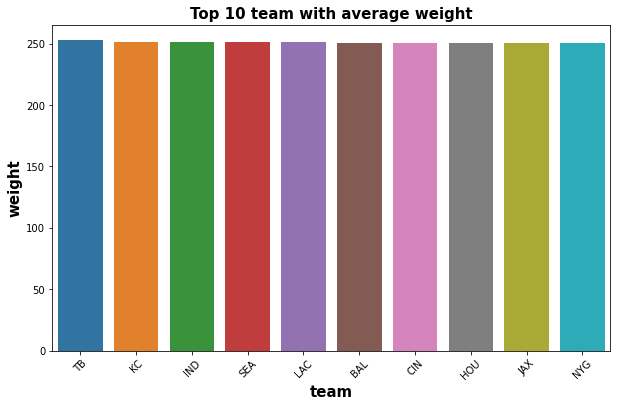

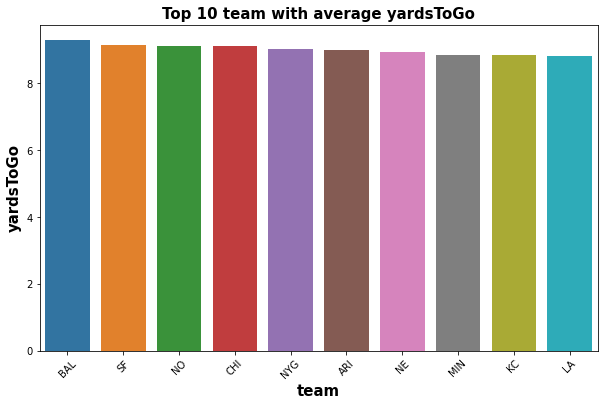

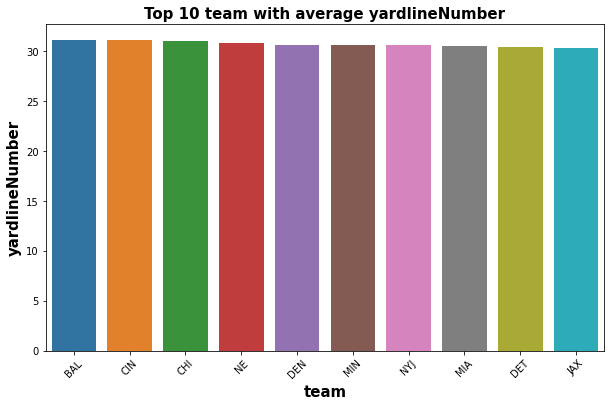

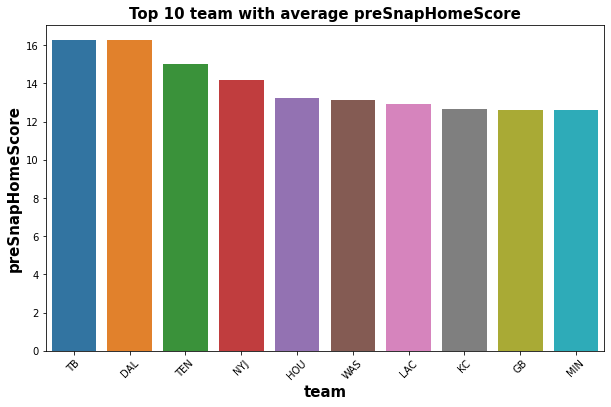

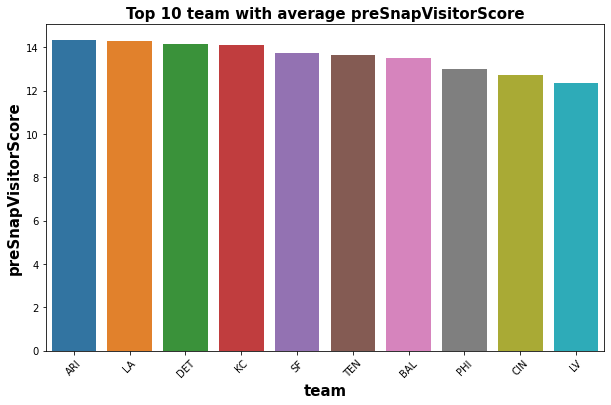

...

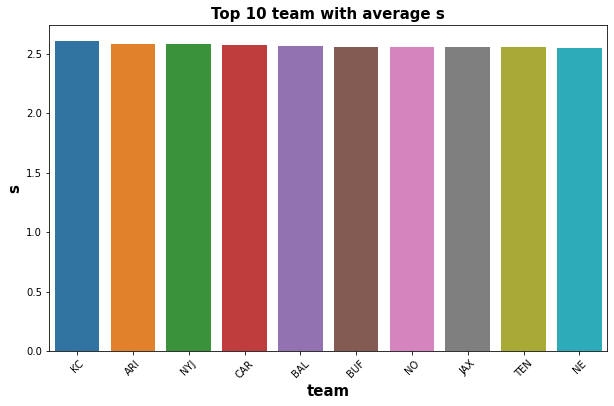

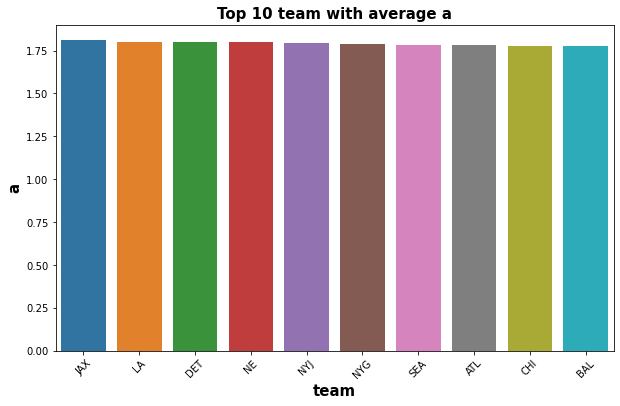

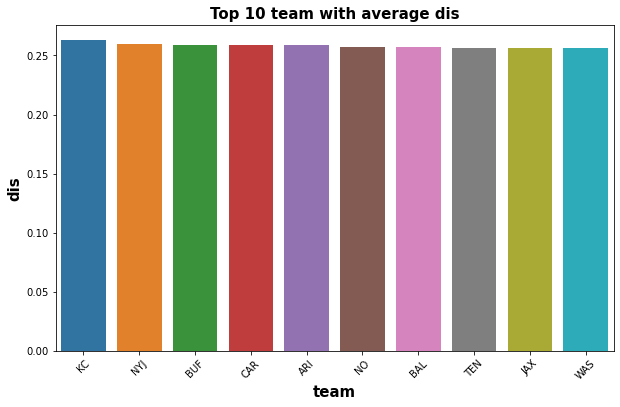

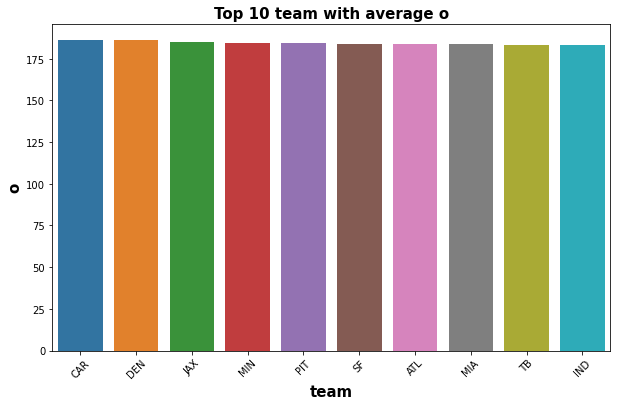

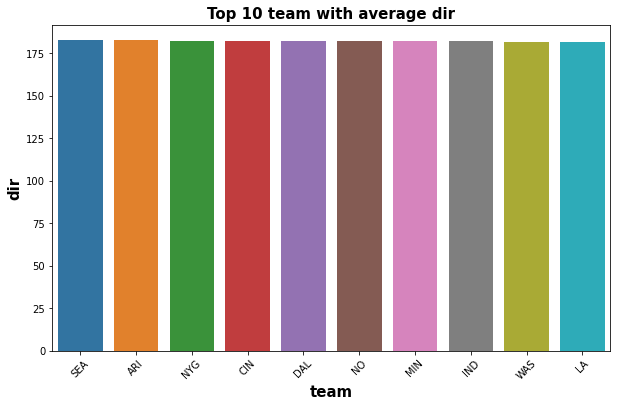

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [76]:
for colx in cat_colsx:
    for coly in num_cols:
        try:
            plt.figure(figsize=(10,6))
            sns.barplot(y=dffresh.groupby(colx)[coly].mean().sort_values(ascending=False)[:10],
                        x=dffresh.groupby(colx)[coly].mean().sort_values(ascending=False).index[:10])
            plt.ylabel(coly,fontsize=15, fontweight='bold')
            plt.xlabel(colx,fontsize=15, fontweight='bold')
            plt.xticks(rotation=45)
            plt.title(f'Top 10 {colx} with average {coly}',fontsize=15, fontweight='bold')
            plt.savefig(f'groupby_{colx}_{coly}.png')
            gc.collect()
            
        except Exception as ex:
            print(f'Error: groupby_{colx}{coly}.png')

In [3]:
xfont = {'family': 'serif',
         'color': 'black',
         'weight': 'bold',
         'size': 12,
        }

yfont = {'family': 'serif',
         'color': 'black',
         'weight': 'bold',
         'size': 12,
        }
title_font = {'family': 'serif',
              'color': 'darkblue',
              'weight': 'bold',
              'size': 18,
             }

In [4]:
box = ['preSnapHomeScore', 'preSnapVisitorScore', 'yardsToGo', 'dis']

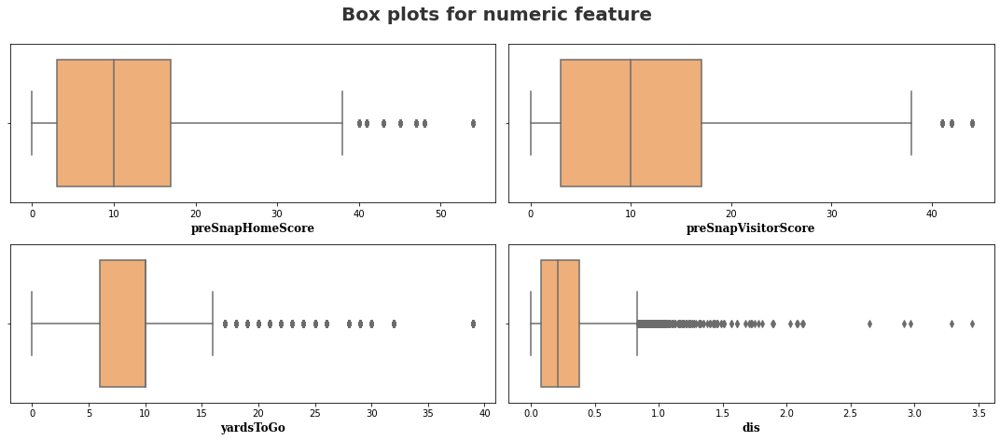

In [36]:
plt.figure(figsize=(15,15))
plt.suptitle("Box plots for numeric feature ", fontsize = 20,fontweight="bold",alpha = 0.8 , y=1.)
for item in range(0,len(box)):
    plt.subplot(5 , 2 , item+1)
    sns.boxplot(x=df[box[item]],color = '#fdae6b',saturation = 0.8)
    plt.xlabel(box[item])
    plt.xlabel(box[item],fontdict=xfont)
    plt.tight_layout()
    gc.collect()

In [19]:
kde = ['x','y','weight','o','dir']

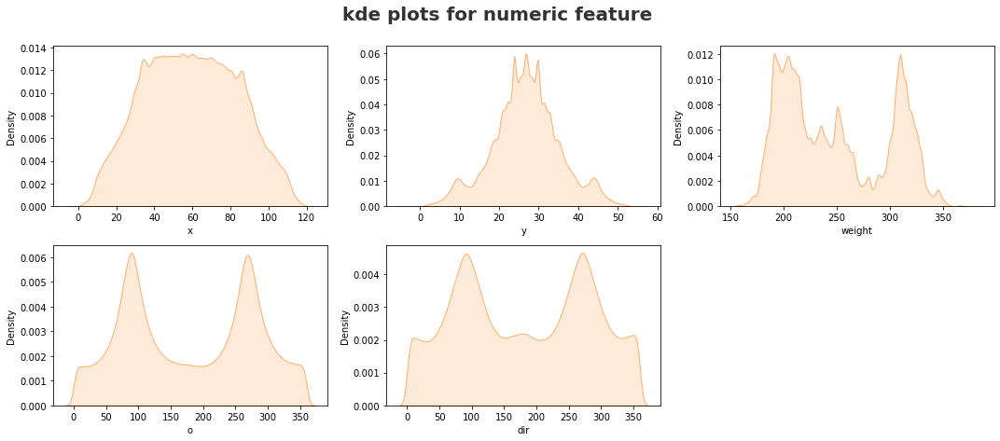

In [22]:
plt.figure(figsize=(15,15))
plt.suptitle("kde plots for numeric feature ", fontsize = 20,fontweight="bold",alpha = 0.8 , y=1.)
for item in range(0,len(kde)):
    plt.subplot(5 , 3 , item+1)
    sns.kdeplot(x=df[kde[item]], color = '#fdae6b', shade = True)
    plt.xlabel(kde[item])
    plt.tight_layout()
    gc.collect()

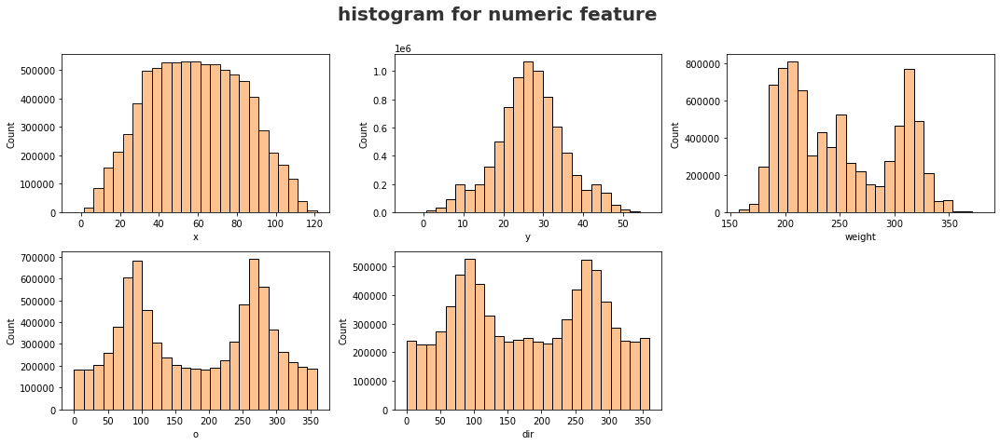

In [24]:
plt.figure(figsize=(15,15))
plt.suptitle("histogram for numeric feature ", fontsize = 20,fontweight="bold",alpha = 0.8 , y=1.)
for item in range(0,len(kde)):
    plt.subplot(5 , 3 , item+1)
    sns.histplot(x=df[kde[item]], color = '#fdae6b',bins =25 )
    plt.xlabel(kde[item])
    plt.tight_layout()
    gc.collect()

In [10]:
cat = ['defendersInBox','down','dropBackType','gameTimeEastern','offenseFormation','passResult','pff_passCoverage','pff_passCoverageType','pff_role','playDirection']
catx = ['defendersInBox','down','gameTimeEastern','offenseFormation',
        'passResult','pff_passCoverageType','pff_role','playDirection']

In [6]:
cat = ['defendersInBox','down','gameTimeEastern','offenseFormation',
       'passResult','pff_passCoverageType','pff_role','playDirection']

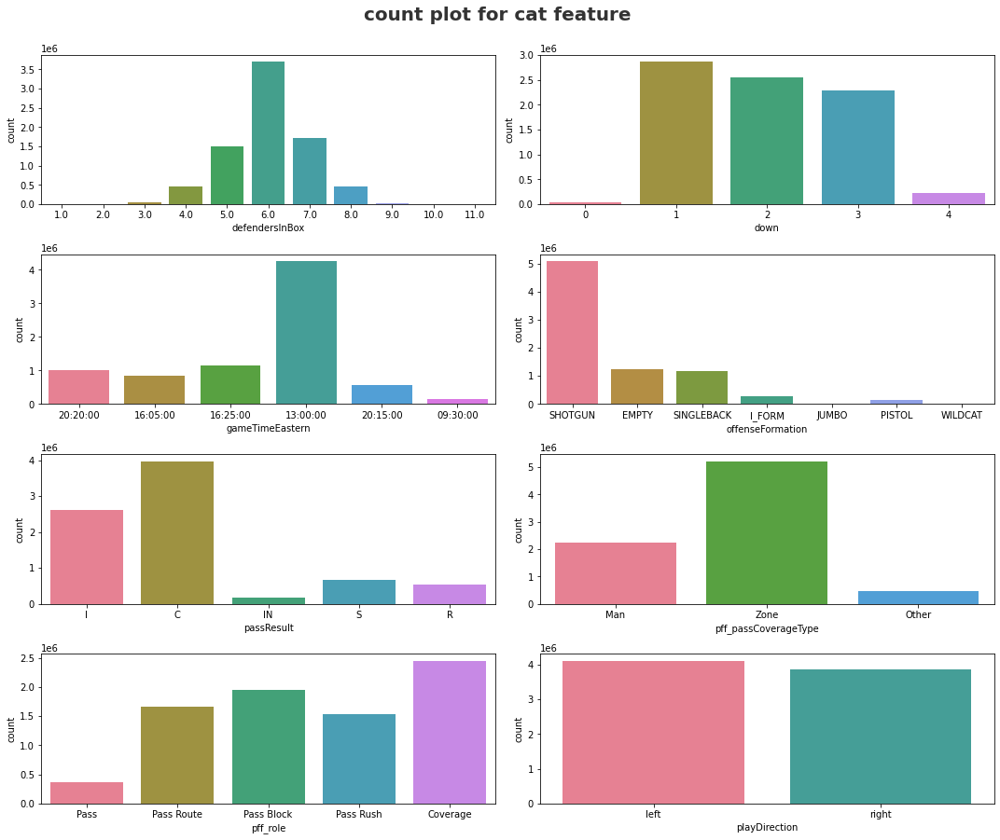

In [11]:
plt.figure(figsize=(15,15))
plt.suptitle("count plot for cat feature ", fontsize = 20,fontweight="bold" , alpha = 0.8 , y=1.)
for item in range(0,len(catx)):
    plt.subplot(5 , 2 , item+1)
    sns.countplot(x=df[catx[item]],palette='husl')
    plt.xlabel(catx[item])
    plt.tight_layout()
    gc.collect()

In [7]:
cat = ['defendersInBox','down','gameTimeEastern','offenseFormation',
       'passResult','pff_passCoverageType','pff_role','playDirection']

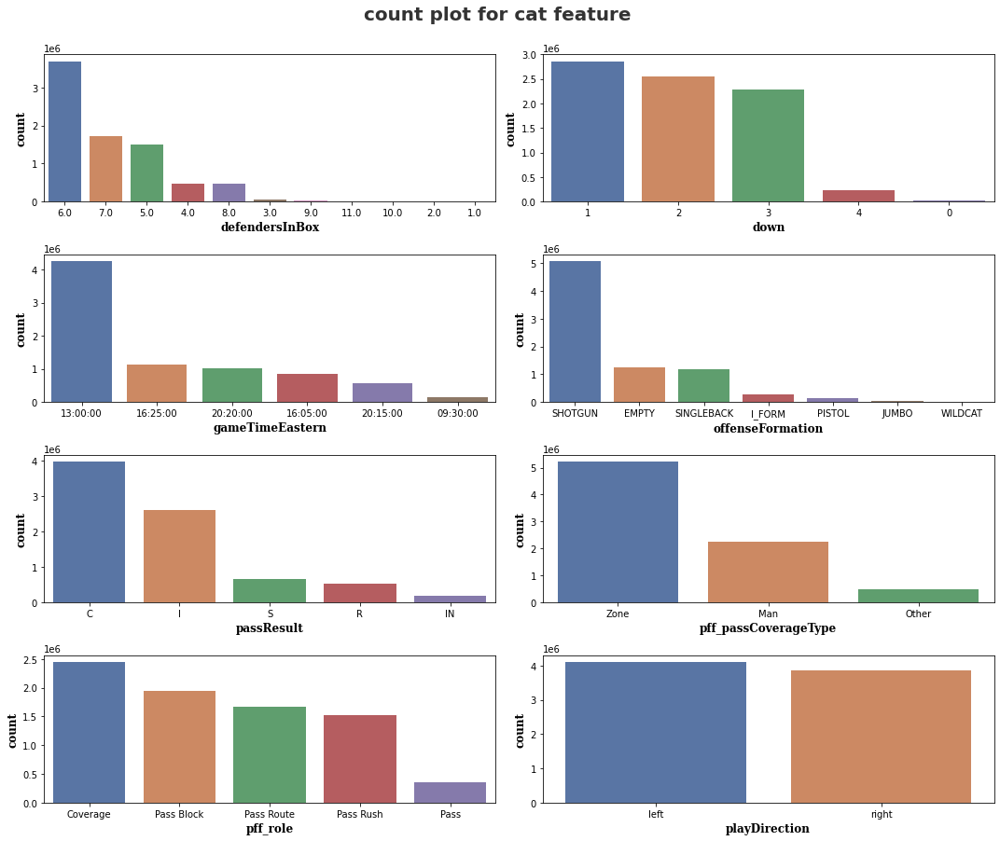

In [11]:
plt.figure(figsize=(15,15))
plt.suptitle("count plot for cat feature ", fontsize = 20,fontweight="bold",alpha = 0.8 , y=1.)
for item in range(0,len(catx)):
    plt.subplot(5 , 2 , item+1)
    sns.countplot(x=df[catx[item]],order =[col[0] for col in df[catx[item]].value_counts().items()],palette='deep')
    plt.xlabel(catx[item],fontdict=xfont)
    plt.ylabel('count',fontdict=yfont)
    plt.xlabel(catx[item])
    plt.tight_layout()
    gc.collect()

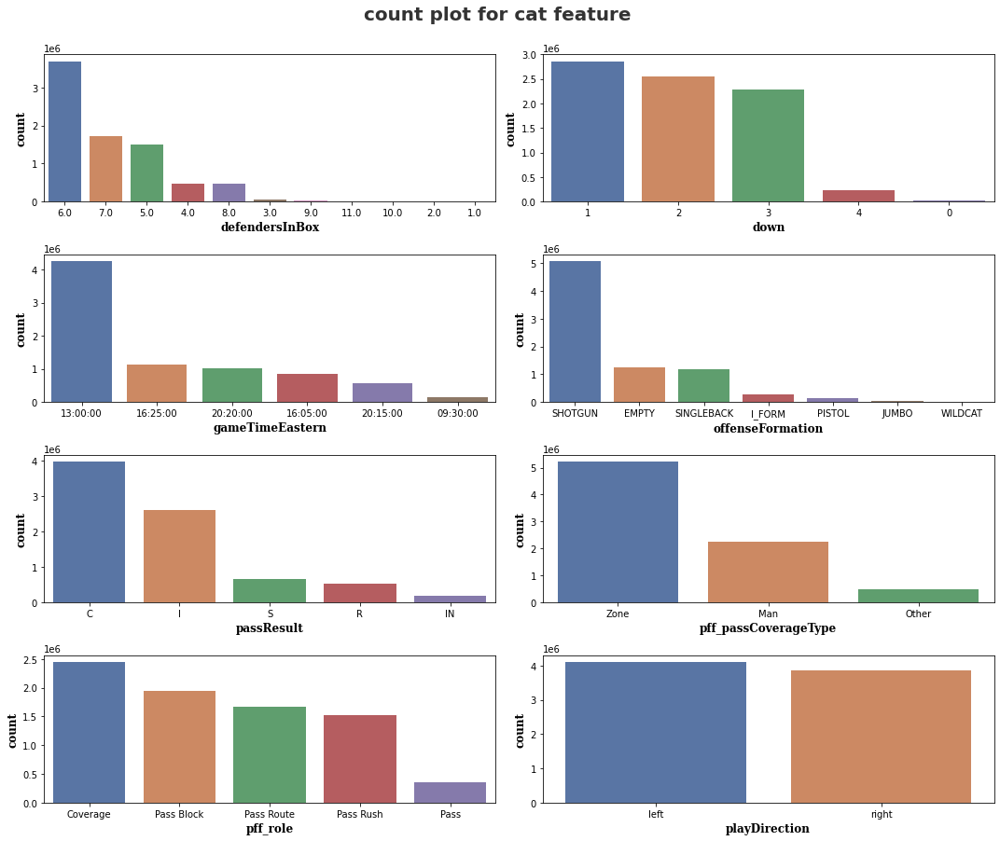

In [12]:
plt.figure(figsize=(15,15))
plt.suptitle("count plot for cat feature ", fontsize = 20,fontweight="bold",alpha = 0.8 , y=1.)
for item in range(0,len(catx)):
    plt.subplot(5 , 2 , item+1)
    sns.countplot(x=df[catx[item]],order =df[catx[item]].value_counts().index,palette='deep')
    plt.xlabel(catx[item],fontdict=xfont)
    plt.ylabel('count',fontdict=yfont)
    plt.xlabel(catx[item])
    plt.tight_layout()
    gc.collect()

In [78]:
[col[0] for col in df['team'].value_counts().items()]

['WAS',
 'KC',
 'TB',
 'MIA',
 'TEN',
 'NYG',
 'CIN',
 'LA',
 'DET',
 'NE',
 'DEN',
 'CAR',
 'BAL',
 'SEA',
 'IND',
 'LV',
 'PHI',
 'BUF',
 'DAL',
 'CLE',
 'ARI',
 'NYJ',
 'ATL',
 'GB',
 'MIN',
 'LAC',
 'NO',
 'JAX',
 'CHI',
 'HOU',
 'SF',
 'PIT']

In [88]:
df['team'].value_counts(10).index[0:10]

Index(['WAS', 'KC', 'TB', 'MIA', 'TEN', 'NYG', 'CIN', 'LA', 'DET', 'NE'], dtype='object')

In [15]:
!pip install wordcloud

In [16]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [20]:
teams = ','.join(df['team'])
teams

'TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,DAL,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB,TB

In [23]:
df['team'].unique()

array(['TB', 'DAL', 'ATL', 'LA', 'NE', 'MIA', 'PHI', 'CHI', 'NO', 'CAR',
       'NYG', 'MIN', 'LAC', 'GB', 'WAS', 'NYJ', 'SF', 'KC', 'LV', 'DET',
       'ARI', 'HOU', 'PIT', 'BUF', 'CIN', 'DEN', 'SEA', 'CLE', 'TEN',
       'JAX', 'BAL', 'IND'], dtype=object)

In [12]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [13]:
teams = ','.join(df['team'])

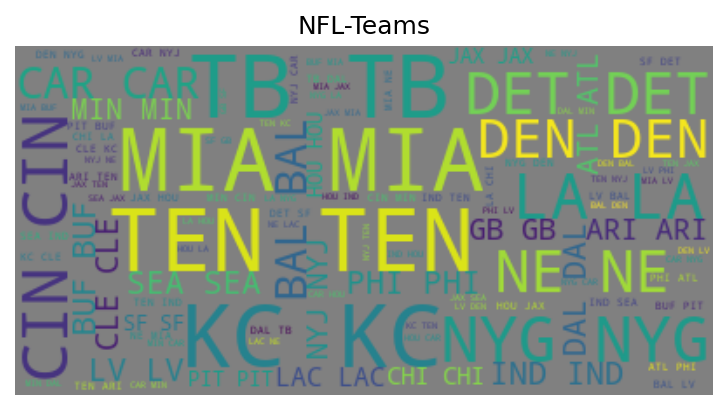

In [63]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(1, 1, 1)
wordcloud = WordCloud(background_color='grey',max_font_size = 50,max_words=100).generate(teams)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
ax.set_title('NFL-Teams')
plt.show()

In [3]:
foul = ['foulName1','foulName2']

In [4]:
df['foulName2'].nunique()

15

In [5]:
df['foulName1'].value_counts(10).index[-10:]

Index(['Illegal Touch Pass', 'Low Block', 'Tripping', 'Illegal Forward Pass',
       'Illegal Shift', 'Disqualification', 'Clipping',
       'Illegal Block Above the Waist', 'Chop Block', 'Illegal Substitution'],
      dtype='object')

In [6]:
xfont = {'family': 'serif',
         'color': 'black',
         'weight': 'bold',
         'size': 12,
        }

yfont = {'family': 'serif',
         'color': 'black',
         'weight': 'bold',
         'size': 12,
        }
title_font = {'family': 'serif',
              'color': 'darkblue',
              'weight': 'bold',
              'size': 18,
             }

In [9]:
foul = ['foulName1','foulName2']

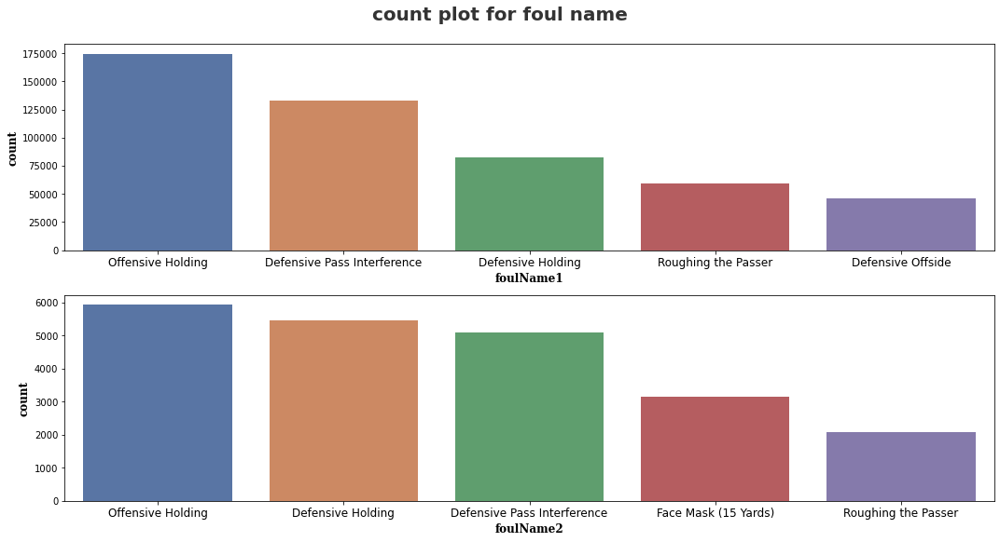

In [8]:
plt.figure(figsize=(15,15))
plt.suptitle("count plot for foul name", fontsize = 20,fontweight="bold" , alpha = 0.8 , y=1.)
for item in range(0,len(foul)):
    plt.subplot(4 , 1 , item+1)
    sns.countplot(x=df[foul[item]],palette='deep',order=df[foul[item]].value_counts(10).index[0:5])
    plt.xlabel(foul[item],fontdict=xfont)
    plt.ylabel('count',fontdict=yfont)
    plt.xticks(fontsize=12)
    plt.tight_layout()
    gc.collect()

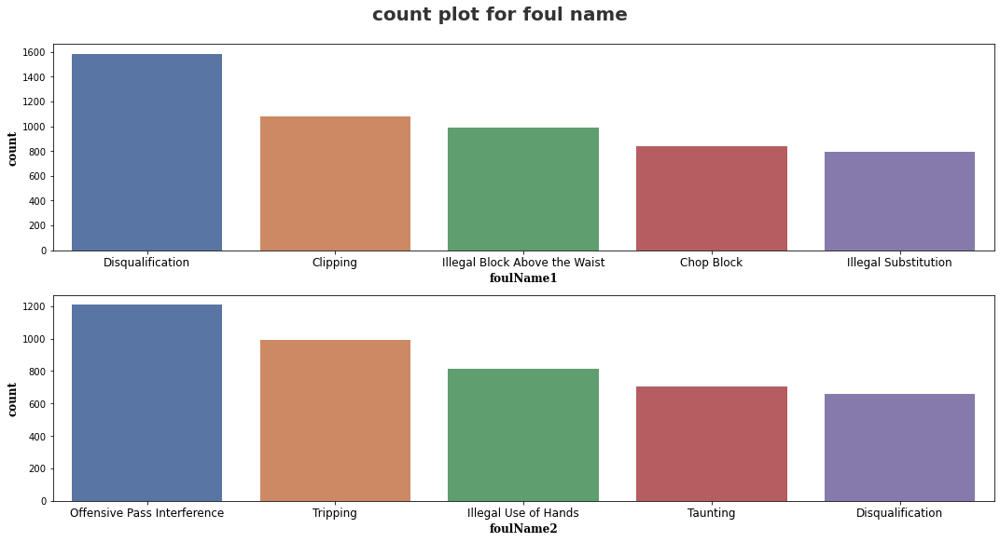

In [11]:
plt.figure(figsize=(15,15))
plt.suptitle("count plot for foul name", fontsize = 20,fontweight="bold" , alpha = 0.8 , y=1.)
for item in range(0,len(foul)):
    plt.subplot(4 , 1 , item+1)
    sns.countplot(x=df[foul[item]],palette='deep',order=df[foul[item]].value_counts().index[-5:])
    plt.xlabel(foul[item])
    plt.xlabel(foul[item],fontdict=xfont)
    plt.ylabel('count',fontdict=yfont)
    plt.xticks(fontsize=12)
    plt.tight_layout()
    gc.collect()

In [44]:
df['team'].value_counts()

WAS    288717
KC     286132
TB     282194
MIA    277596
TEN    274813
NYG    271645
CIN    270413
LA     259391
DET    258885
NE     257686
DEN    257323
CAR    256014
BAL    254166
SEA    253671
IND    249546
LV     245993
PHI    244255
BUF    241428
DAL    241329
CLE    238260
ARI    237842
NYJ    237831
ATL    237017
GB     236973
MIN    233596
LAC    232837
NO     228833
JAX    228668
CHI    228382
HOU    224719
SF     208549
PIT    207988
Name: team, dtype: int64

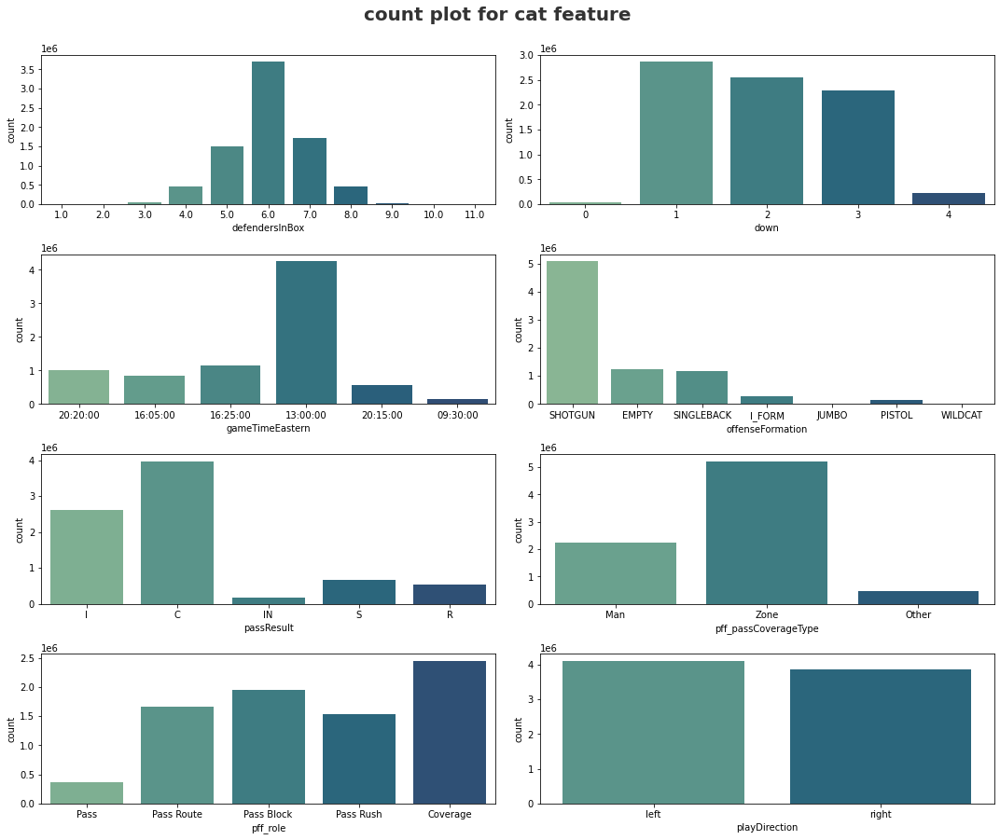

In [50]:
plt.figure(figsize=(15,15))
plt.suptitle("count plot for cat feature ", fontsize = 20,fontweight="bold" , alpha = 0.8 , y=1.)
for item in range(0,len(catx)):
    plt.subplot(5 , 2 , item+1)
    sns.countplot(x=df[catx[item]],palette='crest')
    plt.xlabel(catx[item])
    plt.tight_layout()
    gc.collect()

In [73]:
df['team'].value_counts()[0:10]

WAS    288717
KC     286132
TB     282194
MIA    277596
TEN    274813
NYG    271645
CIN    270413
LA     259391
DET    258885
NE     257686
Name: team, dtype: int64